In [358]:
# Importamos las librerias

import pandas as pd  # Biblioteca para trabajar con estructuras de datos tabulares
import numpy as np  # Biblioteca para operaciones numéricas eficientes

from sklearn.model_selection import cross_val_score, KFold, train_test_split  # Para dividir datos en conjuntos de entrenamiento y prueba
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score  # Para evaluar el rendimiento de los modelos
from sklearn.linear_model import LinearRegression, LogisticRegression, Ridge, Lasso  # Modelos de regresión lineal y regularización
from sklearn.preprocessing import PolynomialFeatures, MinMaxScaler, StandardScaler, OneHotEncoder  # Preprocesamiento de datos
from sklearn.neighbors import KNeighborsRegressor  # Modelo de vecinos más cercanos para regresión
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor  # Modelos de conjunto
from sklearn.pipeline import make_pipeline  # Para crear tuberías de procesamiento de datos

import math  # Biblioteca para funciones matemáticas

import os  # Biblioteca para operaciones relacionadas con el sistema operativo

import matplotlib.pyplot as plt  # Biblioteca para crear gráficos y visualizaciones

import seaborn as sns  # Biblioteca para mejorar la visualización de datos

import statsmodels.api as sm  # Biblioteca para análisis de datos estadísticos
from statsmodels.formula.api import ols  # Módulo para ajuste de modelos lineales

from scipy.stats import norm, skew  # Funciones estadísticas y de distribución

# Web Scraping
from bs4 import BeautifulSoup  # Biblioteca para análisis de documentos HTML
import requests  # Biblioteca para hacer solicitudes HTTP

# Geoespaciales
import folium  # Biblioteca para visualización de mapas interactivos
import geopandas as gpd  # Biblioteca para trabajar con datos geoespaciales

# MySQL
from sqlalchemy import create_engine  # Biblioteca para interactuar con bases de datos MySQL

# Asignación de estaciones
from shapely.geometry import Point  # Biblioteca para operaciones geométricas

# Importar librerías SQL
import mysql.connector  # Biblioteca para conectarse y trabajar con bases de datos SQL

# Importar Libreria -env
from dotenv import load_dotenv  # Biblioteca para cargar variables de entorno desde un archivo .env
import warnings  # Biblioteca para controlar advertencias y mensajes de error

In [359]:
# Distritos - Cargar los datos de distritos desde el archivo JSON
distritos_gdf = gpd.read_file('0301100100_UNITATS_ADM_POLIGONS.json', encoding='latin-1')

# Filtrar los distritos que tienen "TIPUS_UA" igual a "DISTRICTE"
distritos_df = distritos_gdf[distritos_gdf['TIPUS_UA'] == 'DISTRICTE']

# Seleccionar las columnas necesarias
coordenadas_distritos = distritos_df[['CODI_UA', 'NOM', 'geometry']]

# Guardar el DataFrame en un archivo CSV
coordenadas_distritos.to_csv('coordenadas_distritos.csv', index=False)

# Mostrar el DataFrame con las coordenadas poligonales de los distritos
coordenadas_distritos

,CODI_UA,NOM,geometry
1,01,Ciutat Vella,"POLYGON ((431733.736 4582441.816, 431645.093 4..."
2,02,Eixample,"POLYGON ((432033.184 4583665.032, 432033.186 4..."
3,03,Sants-Montjuïc,"MULTIPOLYGON (((428773.911 4580873.742, 428692..."
4,04,Les Corts,"POLYGON ((425054.670 4583672.560, 425047.220 4..."
5,05,Sarrià-Sant Gervasi,"MULTIPOLYGON (((422563.071 4587486.743, 422552..."
6,06,Gràcia,"POLYGON ((427826.987 4586145.355, 427820.696 4..."
7,07,Horta-Guinardó,"POLYGON ((429793.927 4589028.390, 429793.389 4..."
8,08,Nou Barris,"POLYGON ((432115.848 4590999.098, 432010.849 4..."
9,09,Sant Andreu,"POLYGON ((432158.516 4590377.238, 432142.038 4..."
10,10,Sant Martí,"POLYGON ((433770.023 4586475.362, 433726.353 4..."


In [360]:
# Distritos - Web Scraping de la pagina de Wikipedia

url = "https://es.wikipedia.org/wiki/Distritos_de_Barcelona"

# Vemos que respuesta tenemos

response=requests.get(url)

response.status_code

200

In [361]:
# Distritos
#Creo un objeto BeautifulSoup:
soup=BeautifulSoup(response.content, "html.parser")
soup

<!DOCTYPE html>

<html class="client-nojs vector-feature-language-in-header-enabled vector-feature-language-in-main-page-header-disabled vector-feature-sticky-header-disabled vector-feature-page-tools-pinned-disabled vector-feature-toc-pinned-clientpref-1 vector-feature-main-menu-pinned-disabled vector-feature-limited-width-clientpref-1 vector-feature-limited-width-content-enabled vector-feature-zebra-design-disabled vector-feature-custom-font-size-clientpref-disabled vector-feature-client-preferences-disabled vector-feature-typography-survey-disabled vector-toc-available" dir="ltr" lang="es">
<head>
<meta charset="utf-8"/>
<title>Distritos de Barcelona - Wikipedia, la enciclopedia libre</title>
<script>(function(){var className="client-js vector-feature-language-in-header-enabled vector-feature-language-in-main-page-header-disabled vector-feature-sticky-header-disabled vector-feature-page-tools-pinned-disabled vector-feature-toc-pinned-clientpref-1 vector-feature-main-menu-pinned-disa

In [362]:
# Distritos
# Encuentra todas las filas de la tabla
table = soup.find_all('tr')

# Inicializa listas para almacenar los datos de cada columna
numeros = []
distritos = []
imagenes = []
superficies = []
poblaciones = []
densidades = []
barrios = []
regidores = []

# Itera a través de las filas, saltando la primera fila de encabezados
for row in table[1:]:
    # Encuentra todas las celdas en la fila actual
    cells = row.find_all('td')
    
    # Verifica si hay suficientes celdas en esta fila antes de acceder a ellas
    if len(cells) >= 8:
        # Extrae el contenido de cada celda y almacénalo en las listas correspondientes
        numeros.append(cells[0].text.strip())
        distritos.append(cells[1].text.strip())
        imagenes.append(cells[2].find('img')['src'].strip())  # Extrae la URL de la imagen
        superficies.append(cells[3].text.strip())
        poblaciones.append(cells[4].text.strip())
        densidades.append(cells[5].text.strip())
        barrios.append(cells[6].text.strip())
        regidores.append(cells[7].text.strip())

# Crea un DataFrame de pandas con los datos recopilados
data = {
    'Número': numeros,
    'Distrito': distritos,
    'Imagen': imagenes,
    'Superficie km²': superficies,
    'Población (2019)': poblaciones,
    'Densidad hab/km²': densidades,
    'Barrios (nº)': barrios,
    'Regidor': regidores
}

df_Distritos = pd.DataFrame(data)

# Ahora puedes usar df para trabajar con los datos como un DataFrame de pandas
df_Distritos

,Número,Distrito,Imagen,Superficie km²,Población (2019),Densidad hab/km²,Barrios (nº),Regidor
0,1,Ciudad Vieja,//upload.wikimedia.org/wikipedia/commons/thumb...,"4,11",103 429,"25 159,09","El Raval (1), Barrio Gótico (2), La Barcelonet...",Jordi Rabassa (Barcelona en Comú)
1,2,Ensanche,//upload.wikimedia.org/wikipedia/commons/thumb...,"7,46",265 910,"35 625,67","El Fort Pienc (5), Sagrada Familia (6), La Der...",Jordi Martí (Barcelona en Comú)
2,3,Sants-Montjuïc,//upload.wikimedia.org/wikipedia/commons/thumb...,"22,68",184 091,"8118,32","Pueblo Seco (11), La Marina del Prat Vermell (...",Marc Serra (Barcelona en Comú)
3,4,Les Corts,//upload.wikimedia.org/wikipedia/commons/thumb...,"6,02",81 974,"13 607,11","Les Corts (19), La Maternidad y San Ramón (20...",Xavier Marcé (PSC)
4,5,Sarriá-San Gervasio|,//upload.wikimedia.org/wikipedia/commons/thumb...,"19,91",149 260,"7497,11","Vallvidrera, el Tibidabo i les Planes (22), Sa...",Albert Batlle (PSC)
5,6,Gracia,//upload.wikimedia.org/wikipedia/commons/thumb...,"4,19",121 798,"29 082,62","Vallcarca y los Penitentes (28), El Coll (29),...",Eloi Badia (Barcelona en Comú)
6,7,Horta-Guinardó,//upload.wikimedia.org/wikipedia/commons/thumb...,"11,96",171 495,"14 342,64","Baix Guinardó (33), Can Baró (34), El Guinardó...",Rosa Alarcón (PSC)
7,8,Nou Barris,//upload.wikimedia.org/wikipedia/commons/thumb...,"8,05",170 669,"21 198,48","Vilapicina y La Torre Llobeta (44), Porta (45)...",Marga Marí-Klose (PSC)
8,9,San Andrés,//upload.wikimedia.org/wikipedia/commons/thumb...,"6,59",149 821,"22 724,25","La Trinitat Vella (57), Baró de Viver (58), El...",Lucía Martín (Barcelona en Comú)
9,10,San Martín,//upload.wikimedia.org/wikipedia/commons/thumb...,"10,39",238 315,"22 943,58","El Campo del Arpa del Clot (64), El Clot (65),...",David Escudé (PSC)


In [363]:
# Distritos - Eliminas columnas
columnas_a_eliminar = ['Imagen', 'Barrios (nº)', 'Regidor']

# Eliminar las columnas
df_Distritos = df_Distritos.drop(columnas_a_eliminar, axis=1)

In [364]:
# Distritos - Visualizamos
df_Distritos

,Número,Distrito,Superficie km²,Población (2019),Densidad hab/km²
0,1,Ciudad Vieja,"4,11",103 429,"25 159,09"
1,2,Ensanche,"7,46",265 910,"35 625,67"
2,3,Sants-Montjuïc,"22,68",184 091,"8118,32"
3,4,Les Corts,"6,02",81 974,"13 607,11"
4,5,Sarriá-San Gervasio|,"19,91",149 260,"7497,11"
5,6,Gracia,"4,19",121 798,"29 082,62"
6,7,Horta-Guinardó,"11,96",171 495,"14 342,64"
7,8,Nou Barris,"8,05",170 669,"21 198,48"
8,9,San Andrés,"6,59",149 821,"22 724,25"
9,10,San Martín,"10,39",238 315,"22 943,58"


In [365]:
# Distritos - Convertimos las columnas en Float

df_Distritos['Número'] = df_Distritos['Número'].astype(str).str.strip().str.replace(',', '.').str.replace('\xa0', '', regex=True).astype(int)
df_Distritos['Superficie km²'] = df_Distritos['Superficie km²'].astype(str).str.strip().str.replace(',', '.').str.replace('\xa0', '', regex=True).astype(float)
df_Distritos['Población (2019)'] = df_Distritos['Población (2019)'].astype(str).str.strip().str.replace(',', '.').str.replace('\xa0', '', regex=True).astype(float)
df_Distritos['Densidad hab/km²'] = df_Distritos['Densidad hab/km²'].astype(str).str.strip().str.replace(',', '.').str.replace('\xa0', '', regex=True).astype(float)

In [366]:
# Distritos - Visualizamos
df_Distritos

,Número,Distrito,Superficie km²,Población (2019),Densidad hab/km²
0,1,Ciudad Vieja,4.11,103429.0,25159.09
1,2,Ensanche,7.46,265910.0,35625.67
2,3,Sants-Montjuïc,22.68,184091.0,8118.32
3,4,Les Corts,6.02,81974.0,13607.11
4,5,Sarriá-San Gervasio|,19.91,149260.0,7497.11
5,6,Gracia,4.19,121798.0,29082.62
6,7,Horta-Guinardó,11.96,171495.0,14342.64
7,8,Nou Barris,8.05,170669.0,21198.48
8,9,San Andrés,6.59,149821.0,22724.25
9,10,San Martín,10.39,238315.0,22943.58


In [367]:
# Distritos - Renombramos las columnas
df_Distritos = df_Distritos.rename(columns={
    'Número': 'N_Distrito',
    'Distrito': 'Nombre_Distrito',
    'Superficie km²': 'Superficie_km2',
    'Población (2019)': 'Poblacion_2019', 
    'Densidad hab/km²': 'Densidad_hab/km2'
})


In [368]:
# Distritos - Info
df_Distritos.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10 entries, 0 to 9
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   N_Distrito        10 non-null     int32  
 1   Nombre_Distrito   10 non-null     object 
 2   Superficie_km2    10 non-null     float64
 3   Poblacion_2019    10 non-null     float64
 4   Densidad_hab/km2  10 non-null     float64
dtypes: float64(3), int32(1), object(1)
memory usage: 488.0+ bytes


In [369]:
# Distritos - Visualizamos
df_Distritos

,N_Distrito,Nombre_Distrito,Superficie_km2,Poblacion_2019,Densidad_hab/km2
0,1,Ciudad Vieja,4.11,103429.0,25159.09
1,2,Ensanche,7.46,265910.0,35625.67
2,3,Sants-Montjuïc,22.68,184091.0,8118.32
3,4,Les Corts,6.02,81974.0,13607.11
4,5,Sarriá-San Gervasio|,19.91,149260.0,7497.11
5,6,Gracia,4.19,121798.0,29082.62
6,7,Horta-Guinardó,11.96,171495.0,14342.64
7,8,Nou Barris,8.05,170669.0,21198.48
8,9,San Andrés,6.59,149821.0,22724.25
9,10,San Martín,10.39,238315.0,22943.58


In [370]:
# Mapa de Distritos

# Cargar los datos de distritos
distritos_gdf = gpd.read_file('0301100100_UNITATS_ADM_POLIGONS.json', encoding='latin-1')

# Crear un mapa de Folium centrado en una ubicación
m = folium.Map(location=[41.3851, 2.1734], zoom_start=12)  # Ajusta la ubicación y el nivel de zoom según tus necesidades

# Definir un diccionario de colores para los distritos
colors = {
    '01': 'red',
    '02': 'blue',
    '03': 'green',
    '04': 'yellow',
    '05': 'orange',
    '06': 'grey',
    '07': 'purple',
    '08': 'pink',
    '09': 'brown',
    '10': 'cyan'
}

# Función para asignar colores a los distritos según su número de distrito
def color_district(feature):
    # Accede a la clave 'DISTRICTE' dentro de 'properties'
    district_number = feature['properties']['DISTRICTE']
    
    # Utiliza el número de distrito como clave para obtener el color del diccionario
    return {
        'fillColor': colors.get(district_number, 'gray'),  # 'gray' es el color predeterminado si no se encuentra el número de distrito
        'color': 'black',
        'weight': 1,
        'fillOpacity': 0.7
    }

# Agregar los polígonos de distritos al mapa con colores basados en el número de distrito
folium.GeoJson(distritos_gdf, style_function=color_district).add_to(m)

# Guardar el mapa en un archivo HTML
m.save('mapa_interactivo.html')

# Mostrar el mapa en el Jupyter Notebook (si estás utilizando Jupyter Notebook)
m

In [371]:
# Distritos - Guardamos en un csv
df_Distritos.to_csv('df_Distritos.csv', index=False)

### Estaciones

In [221]:
# Estaciones - Cargamos el csv
df_estaciones = pd.read_csv('estaciones.csv', delimiter=',', encoding='latin1')
df_estaciones

,Estacion,Nombre,Lat,Long
0,1,Ciutadella,41.38641,2.1874
1,2,Eixample,41.38531,2.1538
2,3,Poblenou,41.40388,2.2045
3,4,Sants,41.37878,2.1331
4,5,Parc Vall d'HebrÃ³n,41.42611,2.1480
5,6,GrÃ cia,41.39872,2.1534
6,7,Palau Reial,41.38749,2.1152


In [222]:
# Estaciones - Info
df_estaciones.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7 entries, 0 to 6
Data columns (total 4 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   Estacion  7 non-null      int64  
 1   Nombre    7 non-null      object 
 2   Lat       7 non-null      float64
 3   Long      7 non-null      float64
dtypes: float64(2), int64(1), object(1)
memory usage: 352.0+ bytes


In [223]:
# Estaciones -  Cambio los nombres columnas
df_estaciones = df_estaciones.rename(columns={
    'Estacion': 'N_Estacion',
    'Nombre': 'Nombre_Estacion'
})
df_estaciones

,N_Estacion,Nombre_Estacion,Lat,Long
0,1,Ciutadella,41.38641,2.1874
1,2,Eixample,41.38531,2.1538
2,3,Poblenou,41.40388,2.2045
3,4,Sants,41.37878,2.1331
4,5,Parc Vall d'HebrÃ³n,41.42611,2.1480
5,6,GrÃ cia,41.39872,2.1534
6,7,Palau Reial,41.38749,2.1152


In [224]:
# Estaciones - Valores de la columna 'Nombre_Estacion' en una lista
Estacion = df_estaciones['Nombre_Estacion'].unique()

Estacion

array(['Ciutadella', 'Eixample', 'Poblenou', 'Sants',
       "Parc Vall d'HebrÃ³n", 'GrÃ\xa0cia', 'Palau Reial'], dtype=object)

In [225]:
# Estaciones - Renombramos las nombres de las estaciones
mapeo = {
    "Parc Vall d'HebrÃ³n": "Parc Vall d'Hebron",
    'GrÃ\xa0cia': 'Gracia',
}

# Utiliza .str.strip() para eliminar espacios en blanco al principio y al final de los valores
df_estaciones['Nombre_Estacion'] = df_estaciones['Nombre_Estacion'].str.strip()

# Utiliza el método .replace() con el diccionario de mapeo
df_estaciones['Nombre_Estacion'] = df_estaciones['Nombre_Estacion'].replace(mapeo)

# Ahora la columna 'Nombre_Distrito' debería tener los valores reemplazados

df_estaciones

,N_Estacion,Nombre_Estacion,Lat,Long
0,1,Ciutadella,41.38641,2.1874
1,2,Eixample,41.38531,2.1538
2,3,Poblenou,41.40388,2.2045
3,4,Sants,41.37878,2.1331
4,5,Parc Vall d'Hebron,41.42611,2.1480
5,6,Gracia,41.39872,2.1534
6,7,Palau Reial,41.38749,2.1152


In [226]:
# Estaciones - Mapa

# Cargar los datos de distritos y estaciones
distritos_gdf = gpd.read_file('0301100100_UNITATS_ADM_POLIGONS.json', encoding='latin-1')

# Crear un mapa de Folium centrado en una ubicación
m = folium.Map(location=[41.3851, 2.1734], zoom_start=12)  # Ajusta la ubicación y el nivel de zoom según tus necesidades

# Agregar los polígonos de distritos al mapa
folium.GeoJson(distritos_gdf).add_to(m)

# Agregar marcadores de estaciones al mapa
for _, estacion in df_estaciones.iterrows():
    folium.Marker([estacion['Lat'], estacion['Long']], tooltip=estacion['Nombre_Estacion']).add_to(m)

# Guardar el mapa en un archivo HTML
m.save('mapa_interactivo.html')

# Mostrar el mapa en el Jupyter Notebook (si estás utilizando Jupyter Notebook)
m


In [227]:
# Estaciones - Info
df_estaciones.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7 entries, 0 to 6
Data columns (total 4 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   N_Estacion       7 non-null      int64  
 1   Nombre_Estacion  7 non-null      object 
 2   Lat              7 non-null      float64
 3   Long             7 non-null      float64
dtypes: float64(2), int64(1), object(1)
memory usage: 352.0+ bytes


In [228]:
# Estaciones - Visualizamos
df_estaciones

,N_Estacion,Nombre_Estacion,Lat,Long
0,1,Ciutadella,41.38641,2.1874
1,2,Eixample,41.38531,2.1538
2,3,Poblenou,41.40388,2.2045
3,4,Sants,41.37878,2.1331
4,5,Parc Vall d'Hebron,41.42611,2.1480
5,6,Gracia,41.39872,2.1534
6,7,Palau Reial,41.38749,2.1152


In [457]:
# Estaciones - Guardamos en un csv
df_estaciones.to_csv('df_Estaciones.csv', index=False)

### Asignacion de Estaciones

In [381]:
# Estaciones Asignadas - 

# Cargar los datos de distritos y estaciones
#distritos_gdf = gpd.read_file('0301100100_UNITATS_ADM_POLIGONS.json', encoding='latin-1')

# Transformar las coordenadas de los polígonos de distritos a coordenadas de latitud y longitud
distritos_gdf['geometry'] = distritos_gdf['geometry'].to_crs(epsg=4326)

# Calcular el epicentro de cada distrito y encontrar la estación más cercana
asignaciones = {}

for distrito_index, distrito_row in distritos_gdf.iterrows():
    distrito_centroid = distrito_row['geometry'].centroid
    nearest_station_index = df_estaciones.apply(
        lambda row: distrito_centroid.distance(Point(row['Long'], row['Lat'])),
        axis=1
    ).idxmin()
    
    nearest_station = df_estaciones.loc[nearest_station_index, 'Nombre_Estacion']
    asignaciones[distrito_row['DISTRICTE']] = nearest_station

# Crear un DataFrame con las asignaciones
df_asignaciones = pd.DataFrame(list(asignaciones.items()), columns=['N_Distrito', 'Nombre_Estacion'])

df_asignaciones

,N_Distrito,Nombre_Estacion
0,-,Gracia
1,01,Ciutadella
2,02,Eixample
3,03,Sants
4,04,Palau Reial
5,05,Gracia
6,06,Gracia
7,07,Parc Vall d'Hebron
8,08,Parc Vall d'Hebron
9,09,Poblenou


In [382]:
# Reemplaza los guiones con NaN
df_asignaciones['N_Distrito'] = df_asignaciones['N_Distrito'].replace('-', np.nan)

# Elimina las filas que contienen NaN en la columna 'N_Distrito'
df_asignaciones = df_asignaciones.dropna(subset=['N_Distrito'])

# Convierte 'N_Distrito' a tipo entero (int)
df_asignaciones['N_Distrito'] = df_asignaciones['N_Distrito'].astype(int)

# Contaminacion - Agragamos la columna 'Nombre_Estacion' al DataFrame
df_asignaciones = df_asignaciones.merge(df_estaciones[['Nombre_Estacion', 'N_Estacion']], on='Nombre_Estacion', how='left')

# Lista con el nuevo orden de las columnas
new_column_order = ['N_Distrito', 'N_Estacion', 'Nombre_Estacion']

# Reordena las columnas del DataFrame
df_asignaciones = df_asignaciones[new_column_order]

# Muestra el DataFrame resultante
df_asignaciones

C:\Users\aguva\AppData\Local\Temp\ipykernel_28824\965288097.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asignaciones['N_Distrito'] = df_asignaciones['N_Distrito'].astype(int)


,N_Distrito,N_Estacion,Nombre_Estacion
0,1,1,Ciutadella
1,2,2,Eixample
2,3,4,Sants
3,4,7,Palau Reial
4,5,6,Gracia
5,6,6,Gracia
6,7,5,Parc Vall d'Hebron
7,8,5,Parc Vall d'Hebron
8,9,3,Poblenou
9,10,3,Poblenou


In [383]:
# Estaciones Asignadas - Info
df_asignaciones.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10 entries, 0 to 9
Data columns (total 3 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   N_Distrito       10 non-null     int32 
 1   N_Estacion       10 non-null     int64 
 2   Nombre_Estacion  10 non-null     object
dtypes: int32(1), int64(1), object(1)
memory usage: 280.0+ bytes


In [438]:
# Estaciones Asignadas - Guardamos en un csv

# Guardar el DataFrame en un archivo CSV
df_asignaciones.to_csv('df_Asignaciones.csv', index=False)

### Movilidad

In [31]:
# Moviliad - Web Scrapping de la pagina del Ajuntamiento de Barcelona - Datos evolutivos de la encuesta de movilidad en día laborable (EMEF) en Barcelona.

# Medio de transporte utilizado en Barcelona por distritos. 2011-2021

url2 = 'https://ajuntament.barcelona.cat/estadistica/castella/Estadistiques_per_temes/Transport_i_mobilitat/Mobilitat/Enquesta_mobilitat_dia_feiner/evo/t1.htm'

# Haz una solicitud GET a la URL
response2 = requests.get(url2)

# Crea un objeto BeautifulSoup con el contenido de la respuesta
soup2 = BeautifulSoup(response2.content, 'html.parser')

soup2

<!DOCTYPE HTML PUBLIC "-//W3C//DTD HTML 4.01 Transitional//EN" "http://www.w3.org/TR/html4/loose.dtd">

<html>
<head>
<title>Medio de transporte utilizado en Barcelona por distritos. 2011-2021</title>
<script language="JavaScript" src="funcions.js"></script>
<script language="JavaScript" src="estructura.js"></script>
<script language="Javascript">whpreload()</script>
</head>
<body leftmargin="0" marginheight="0" marginwidth="0" topmargin="0">
<script language="JavaScript">document.write(makeheader());</script>
<table border="0" cellpadding="0" cellspacing="2" width="1">
<tr><td class="WhadsTitVar1" colspan="7" nowrap="" valign="bottom">1. Datos evolutivos de la encuesta de movilidad en dĒa laborable (EMEF) en Barcelona.</td></tr>
<tr><td bgcolor="#000000" colspan="7"><script language="javascript">document.write('<img src="' + whpath + 'images/cpbk.gif" border="0" width="100%" height="2">')</script></td></tr>
<tr><td class="WhadsTitVar2" colspan="7" nowrap="" valign="bottom">1.1. Medio 

In [119]:
# Moviliad - Extraccion del Scrapping

# Extraemos la información de la tabla de la pagina
rows2 = soup2.find_all('tr')

data2 = []

# Para cada fila...
for row in rows2:
    # Encuentra todas las celdas 'td'
    tds2 = row.find_all('td')
    if len(tds2) == 5:  # Asegúrate de que hay exactamente 5 celdas 'td'
        # Extrae el texto de cada celda y añádelo a los datos
        ubicacion = tds2[0].text.strip()
        datos = [td.text.strip() for td in tds2[1:]]
        data2.append([ubicacion] + datos)

# Crea un DataFrame con los datos
df_movilidad = pd.DataFrame(data2, columns=['Ubicación', 'Total', 'A pie', 'Bicicleta', 'Motocicleta'])

# Moviliad - Seleccionamos las filas de interes
df_movilidad.columns = df_movilidad.iloc[0]
df_movilidad = df_movilidad.iloc[1:]

df_movilidad


,Distritos,TOTAL,A piķ + bicicleta,Transporte privado,Transporte p·blico
1,,,,,
2,2011,5.360.212,2.716.527,1.011.131,1.632.554
3,1. Ciutat Vella,335.582,176.415,40.246,118.921
4,2. Eixample,847.105,409.283,158.457,279.365
5,3. Sants-Montju’c,622.331,362.456,94.530,165.345
...,...,...,...,...,...
128,6. GrÓcia,369.310,211.213,85.238,72.859
129,7. Horta-Guinard¾,488.299,236.390,114.471,137.437
130,8. Nou Barris,465.803,227.187,93.683,144.933
131,9. Sant Andreu,467.601,265.432,95.044,107.124


In [120]:
# Movilidad - Shape
df_movilidad.shape

(132, 5)

In [121]:
# Moviliad - Info
df_movilidad.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 132 entries, 1 to 132
Data columns (total 5 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   Distritos           132 non-null    object
 1   TOTAL               132 non-null    object
 2   A piķ + bicicleta   132 non-null    object
 3   Transporte privado  132 non-null    object
 4   Transporte p·blico  132 non-null    object
dtypes: object(5)
memory usage: 5.3+ KB


In [122]:
# Movilidad - Eliminamos los valores nulos
df_movilidad = df_movilidad.dropna()
df_movilidad

,Distritos,TOTAL,A piķ + bicicleta,Transporte privado,Transporte p·blico
1,,,,,
2,2011,5.360.212,2.716.527,1.011.131,1.632.554
3,1. Ciutat Vella,335.582,176.415,40.246,118.921
4,2. Eixample,847.105,409.283,158.457,279.365
5,3. Sants-Montju’c,622.331,362.456,94.530,165.345
...,...,...,...,...,...
128,6. GrÓcia,369.310,211.213,85.238,72.859
129,7. Horta-Guinard¾,488.299,236.390,114.471,137.437
130,8. Nou Barris,465.803,227.187,93.683,144.933
131,9. Sant Andreu,467.601,265.432,95.044,107.124


In [123]:
# Movilidad - Tranformamos los datos a Int

df_movilidad['TOTAL'] = pd.to_numeric(df_movilidad['TOTAL'], errors='coerce')
df_movilidad['A piķ + bicicleta'] = pd.to_numeric(df_movilidad['A piķ + bicicleta'], errors='coerce')
df_movilidad['Transporte privado'] = pd.to_numeric(df_movilidad['Transporte privado'], errors='coerce')
df_movilidad['Transporte p·blico'] = pd.to_numeric(df_movilidad['Transporte p·blico'], errors='coerce')


In [124]:
# Movilidad - Visualizamos el DataFrame
df_movilidad

,Distritos,TOTAL,A piķ + bicicleta,Transporte privado,Transporte p·blico
1,,NaN,NaN,NaN,NaN
2,2011,NaN,NaN,NaN,NaN
3,1. Ciutat Vella,335.582,176.415,40.246,118.921
4,2. Eixample,847.105,409.283,158.457,279.365
5,3. Sants-Montju’c,622.331,362.456,94.530,165.345
...,...,...,...,...,...
128,6. GrÓcia,369.310,211.213,85.238,72.859
129,7. Horta-Guinard¾,488.299,236.390,114.471,137.437
130,8. Nou Barris,465.803,227.187,93.683,144.933
131,9. Sant Andreu,467.601,265.432,95.044,107.124


In [125]:
# Movilidad
df_movilidad2 = df_movilidad.copy()
df_movilidad2 = df_movilidad.replace(r'^\s*$', np.nan, regex=True)
df_movilidad2 = df_movilidad.dropna()
df_movilidad2

,Distritos,TOTAL,A piķ + bicicleta,Transporte privado,Transporte p·blico
3,1. Ciutat Vella,335.582,176.415,40.246,118.921
4,2. Eixample,847.105,409.283,158.457,279.365
5,3. Sants-Montju’c,622.331,362.456,94.530,165.345
6,4. Les Corts,262.529,126.341,66.848,69.340
7,5. SarriÓ-Sant Gervasi,501.912,246.280,127.305,128.327
...,...,...,...,...,...
128,6. GrÓcia,369.310,211.213,85.238,72.859
129,7. Horta-Guinard¾,488.299,236.390,114.471,137.437
130,8. Nou Barris,465.803,227.187,93.683,144.933
131,9. Sant Andreu,467.601,265.432,95.044,107.124


In [126]:
# Movilidad - Info
df_movilidad2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 110 entries, 3 to 132
Data columns (total 5 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Distritos           110 non-null    object 
 1   TOTAL               110 non-null    float64
 2   A piķ + bicicleta   110 non-null    float64
 3   Transporte privado  110 non-null    float64
 4   Transporte p·blico  110 non-null    float64
dtypes: float64(4), object(1)
memory usage: 5.2+ KB


In [127]:
# Movilidad - Agregamos el año
year = np.repeat(range(2011, 2011 + len(df_movilidad2) // 10 + 1), 10)
year = year[:len(df_movilidad2)]
df_movilidad2 = df_movilidad2.copy()  # Crea una copia independiente del DataFrame original
df_movilidad2['Year'] = year
df_movilidad2

,Distritos,TOTAL,A piķ + bicicleta,Transporte privado,Transporte p·blico,Year
3,1. Ciutat Vella,335.582,176.415,40.246,118.921,2011
4,2. Eixample,847.105,409.283,158.457,279.365,2011
5,3. Sants-Montju’c,622.331,362.456,94.530,165.345,2011
6,4. Les Corts,262.529,126.341,66.848,69.340,2011
7,5. SarriÓ-Sant Gervasi,501.912,246.280,127.305,128.327,2011
...,...,...,...,...,...,...
128,6. GrÓcia,369.310,211.213,85.238,72.859,2021
129,7. Horta-Guinard¾,488.299,236.390,114.471,137.437,2021
130,8. Nou Barris,465.803,227.187,93.683,144.933,2021
131,9. Sant Andreu,467.601,265.432,95.044,107.124,2021


In [128]:
# Movilidad - Separamos el numero de distrito en dos columnas
df_movilidad3 = df_movilidad2.copy()
df_movilidad3[['Distrito', 'Nombre_Distrito']] = df_movilidad3['Distritos'].str.split(pat='.', n=1, expand=True)
df_movilidad3

,Distritos,TOTAL,A piķ + bicicleta,Transporte privado,Transporte p·blico,Year,Distrito,Nombre_Distrito
3,1. Ciutat Vella,335.582,176.415,40.246,118.921,2011,1,Ciutat Vella
4,2. Eixample,847.105,409.283,158.457,279.365,2011,2,Eixample
5,3. Sants-Montju’c,622.331,362.456,94.530,165.345,2011,3,Sants-Montju’c
6,4. Les Corts,262.529,126.341,66.848,69.340,2011,4,Les Corts
7,5. SarriÓ-Sant Gervasi,501.912,246.280,127.305,128.327,2011,5,SarriÓ-Sant Gervasi
...,...,...,...,...,...,...,...,...
128,6. GrÓcia,369.310,211.213,85.238,72.859,2021,6,GrÓcia
129,7. Horta-Guinard¾,488.299,236.390,114.471,137.437,2021,7,Horta-Guinard¾
130,8. Nou Barris,465.803,227.187,93.683,144.933,2021,8,Nou Barris
131,9. Sant Andreu,467.601,265.432,95.044,107.124,2021,9,Sant Andreu


In [129]:
# Movilidad - Ordenamos las columnas
df_movilidad4 = df_movilidad3.copy()

# Elimina la columna 'Distrito'
df_movilidad4 = df_movilidad4.drop('Distritos', axis=1)

# Reordena las columnas
df_movilidad4 = df_movilidad4[['Year', 'Distrito', 'Nombre_Distrito', 'A piķ + bicicleta', 'Transporte privado', 'Transporte p·blico', 'TOTAL']]

df_movilidad4


,Year,Distrito,Nombre_Distrito,A piķ + bicicleta,Transporte privado,Transporte p·blico,TOTAL
3,2011,1,Ciutat Vella,176.415,40.246,118.921,335.582
4,2011,2,Eixample,409.283,158.457,279.365,847.105
5,2011,3,Sants-Montju’c,362.456,94.530,165.345,622.331
6,2011,4,Les Corts,126.341,66.848,69.340,262.529
7,2011,5,SarriÓ-Sant Gervasi,246.280,127.305,128.327,501.912
...,...,...,...,...,...,...,...
128,2021,6,GrÓcia,211.213,85.238,72.859,369.310
129,2021,7,Horta-Guinard¾,236.390,114.471,137.437,488.299
130,2021,8,Nou Barris,227.187,93.683,144.933,465.803
131,2021,9,Sant Andreu,265.432,95.044,107.124,467.601


In [130]:
# Movilidad - Info
df_movilidad4.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 110 entries, 3 to 132
Data columns (total 7 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Year                110 non-null    int32  
 1   Distrito            110 non-null    object 
 2   Nombre_Distrito     110 non-null    object 
 3   A piķ + bicicleta   110 non-null    float64
 4   Transporte privado  110 non-null    float64
 5   Transporte p·blico  110 non-null    float64
 6   TOTAL               110 non-null    float64
dtypes: float64(4), int32(1), object(2)
memory usage: 6.4+ KB


In [131]:
# Movilidad - Cambio nombres columnas

# Movilidad - Cambio los nombres de las columnas
df_movilidad4 = df_movilidad4.rename(columns={
    'Year': 'Anio',
    'Distrito': 'N_Distrito',
    'A piķ + bicicleta': 'Movilidad_Activa',
    'Transporte privado': 'Transporte_Privado',
    'Transporte p·blico': 'Transporte_Publico',
    'TOTAL': 'Total'
})
df_movilidad4

# Asegúrate de que las columnas "Año" y "N_Estacion" sean de tipo cadena (string)
df_movilidad4['Anio'] = df_movilidad4['Anio'].astype(str)
df_movilidad4['N_Distrito'] = df_movilidad4['N_Distrito'].astype(str)

# Obtén los dos últimos caracteres de la columna "Año" y "N_Estacion" con ceros agregados si es necesario
df_movilidad4['ID_Movilidad'] = df_movilidad4['Anio'].str[-2:] + df_movilidad4['N_Distrito'].str[-2:].str.zfill(2)

# Asegúrate de que las columnas "Año" y "N_Estacion" sean de tipo cadena (string)
df_movilidad4['Anio'] = df_movilidad4['Anio'].astype(int)
df_movilidad4['N_Distrito'] = df_movilidad4['N_Distrito'].astype(int)

# Ordenar las columnas
column_order = ['ID_Movilidad', 'Anio', 'N_Distrito', 'Nombre_Distrito', 'Movilidad_Activa', 'Transporte_Privado', 'Transporte_Publico', 'Total']

# Reordena las columnas del DataFrame
df_movilidad4 = df_movilidad4[column_order]

df_movilidad4

,ID_Movilidad,Anio,N_Distrito,Nombre_Distrito,Movilidad_Activa,Transporte_Privado,Transporte_Publico,Total
3,1101,2011,1,Ciutat Vella,176.415,40.246,118.921,335.582
4,1102,2011,2,Eixample,409.283,158.457,279.365,847.105
5,1103,2011,3,Sants-Montju’c,362.456,94.530,165.345,622.331
6,1104,2011,4,Les Corts,126.341,66.848,69.340,262.529
7,1105,2011,5,SarriÓ-Sant Gervasi,246.280,127.305,128.327,501.912
...,...,...,...,...,...,...,...,...
128,2106,2021,6,GrÓcia,211.213,85.238,72.859,369.310
129,2107,2021,7,Horta-Guinard¾,236.390,114.471,137.437,488.299
130,2108,2021,8,Nou Barris,227.187,93.683,144.933,465.803
131,2109,2021,9,Sant Andreu,265.432,95.044,107.124,467.601


In [132]:
# Movilidad - Info
df_movilidad4.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 110 entries, 3 to 132
Data columns (total 8 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   ID_Movilidad        110 non-null    object 
 1   Anio                110 non-null    int32  
 2   N_Distrito          110 non-null    int32  
 3   Nombre_Distrito     110 non-null    object 
 4   Movilidad_Activa    110 non-null    float64
 5   Transporte_Privado  110 non-null    float64
 6   Transporte_Publico  110 non-null    float64
 7   Total               110 non-null    float64
dtypes: float64(4), int32(2), object(2)
memory usage: 6.9+ KB


In [133]:
# Movilidad - Value Count 'Nombre Distrito'
df_movilidad4['Nombre_Distrito'].value_counts()

 Ciutat Vella           11
 Sants-Montju’c         11
 Les Corts              11
 SarriÓ-Sant Gervasi    11
 GrÓcia                 11
 Horta-Guinard¾         11
 Nou Barris             11
 Sant Andreu            11
 Sant MartĒ             11
 Eixample                8
 L'Eixample              3
Name: Nombre_Distrito, dtype: int64

In [134]:
# Movilidad - Cambio de valores Nombre_Distrito
mapeo = {
    "Sants-Montju’c": 'Sants-Montjuic',
    'SarriÓ-Sant Gervasi': 'Sarria-Sant Gervasi',
    'GrÓcia': 'Gracia',
    'Horta-Guinard¾': 'Horta-Guinardo',
    'Sant MartĒ': 'Sant Marti',
    "L'Eixample": 'Eixample'
}

# Utiliza .str.strip() para eliminar espacios en blanco al principio y al final de los valores
df_movilidad4['Nombre_Distrito'] = df_movilidad4['Nombre_Distrito'].str.strip()

# Utiliza el método .replace() con el diccionario de mapeo
df_movilidad4['Nombre_Distrito'] = df_movilidad4['Nombre_Distrito'].replace(mapeo)

# Ahora la columna 'Nombre_Distrito' debería tener los valores reemplazados

df_movilidad4


,ID_Movilidad,Anio,N_Distrito,Nombre_Distrito,Movilidad_Activa,Transporte_Privado,Transporte_Publico,Total
3,1101,2011,1,Ciutat Vella,176.415,40.246,118.921,335.582
4,1102,2011,2,Eixample,409.283,158.457,279.365,847.105
5,1103,2011,3,Sants-Montjuic,362.456,94.530,165.345,622.331
6,1104,2011,4,Les Corts,126.341,66.848,69.340,262.529
7,1105,2011,5,Sarria-Sant Gervasi,246.280,127.305,128.327,501.912
...,...,...,...,...,...,...,...,...
128,2106,2021,6,Gracia,211.213,85.238,72.859,369.310
129,2107,2021,7,Horta-Guinardo,236.390,114.471,137.437,488.299
130,2108,2021,8,Nou Barris,227.187,93.683,144.933,465.803
131,2109,2021,9,Sant Andreu,265.432,95.044,107.124,467.601


In [135]:
'''# Movilidad - 1. Convierte a cadena
df_movilidad4['Movilidad_Activa'] = df_movilidad4['Movilidad_Activa'].astype(str)
df_movilidad4['Total'] = df_movilidad4['Total'].astype(str)
df_movilidad4['Transporte_Privado'] = df_movilidad4['Transporte_Privado'].astype(str)
df_movilidad4['Transporte_Publico'] = df_movilidad4['Transporte_Publico'].astype(str)'''


"# Movilidad - 1. Convierte a cadena\ndf_movilidad4['Movilidad_Activa'] = df_movilidad4['Movilidad_Activa'].astype(str)\ndf_movilidad4['Total'] = df_movilidad4['Total'].astype(str)\ndf_movilidad4['Transporte_Privado'] = df_movilidad4['Transporte_Privado'].astype(str)\ndf_movilidad4['Transporte_Publico'] = df_movilidad4['Transporte_Publico'].astype(str)"

In [136]:
#Movilidad - Info
df_movilidad4.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 110 entries, 3 to 132
Data columns (total 8 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   ID_Movilidad        110 non-null    object 
 1   Anio                110 non-null    int32  
 2   N_Distrito          110 non-null    int32  
 3   Nombre_Distrito     110 non-null    object 
 4   Movilidad_Activa    110 non-null    float64
 5   Transporte_Privado  110 non-null    float64
 6   Transporte_Publico  110 non-null    float64
 7   Total               110 non-null    float64
dtypes: float64(4), int32(2), object(2)
memory usage: 6.9+ KB


In [137]:
'''# Movilidad - 2. Quita los puntos
df_movilidad4['Movilidad_Activa'] = df_movilidad4['Movilidad_Activa'].str.replace('.', '')
df_movilidad4['Total'] = df_movilidad4['Total'].str.replace('.', '')
df_movilidad4['Transporte_Privado'] = df_movilidad4['Transporte_Privado'].str.replace('.', '')
df_movilidad4['Transporte_Publico'] = df_movilidad4['Transporte_Publico'].str.replace('.', '')
df_movilidad4'''

"# Movilidad - 2. Quita los puntos\ndf_movilidad4['Movilidad_Activa'] = df_movilidad4['Movilidad_Activa'].str.replace('.', '')\ndf_movilidad4['Total'] = df_movilidad4['Total'].str.replace('.', '')\ndf_movilidad4['Transporte_Privado'] = df_movilidad4['Transporte_Privado'].str.replace('.', '')\ndf_movilidad4['Transporte_Publico'] = df_movilidad4['Transporte_Publico'].str.replace('.', '')\ndf_movilidad4"

In [138]:
'''# Movilidad - 3. Convierte a entero
df_movilidad4['Movilidad_Activa'] = df_movilidad4['Movilidad_Activa'].astype(int)
df_movilidad4['Total'] = df_movilidad4['Total'].astype(int)
df_movilidad4['Transporte_Privado'] = df_movilidad4['Transporte_Privado'].astype(int)
df_movilidad4['Transporte_Publico'] = df_movilidad4['Transporte_Publico'].astype(int)
df_movilidad4'''

"# Movilidad - 3. Convierte a entero\ndf_movilidad4['Movilidad_Activa'] = df_movilidad4['Movilidad_Activa'].astype(int)\ndf_movilidad4['Total'] = df_movilidad4['Total'].astype(int)\ndf_movilidad4['Transporte_Privado'] = df_movilidad4['Transporte_Privado'].astype(int)\ndf_movilidad4['Transporte_Publico'] = df_movilidad4['Transporte_Publico'].astype(int)\ndf_movilidad4"

In [139]:
# Movilidad - Value Counts 'Nombre Distrito'
df_movilidad4['Nombre_Distrito'].value_counts()

Ciutat Vella           11
Eixample               11
Sants-Montjuic         11
Les Corts              11
Sarria-Sant Gervasi    11
Gracia                 11
Horta-Guinardo         11
Nou Barris             11
Sant Andreu            11
Sant Marti             11
Name: Nombre_Distrito, dtype: int64

In [140]:
# Movilidad - Info
df_movilidad4.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 110 entries, 3 to 132
Data columns (total 8 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   ID_Movilidad        110 non-null    object 
 1   Anio                110 non-null    int32  
 2   N_Distrito          110 non-null    int32  
 3   Nombre_Distrito     110 non-null    object 
 4   Movilidad_Activa    110 non-null    float64
 5   Transporte_Privado  110 non-null    float64
 6   Transporte_Publico  110 non-null    float64
 7   Total               110 non-null    float64
dtypes: float64(4), int32(2), object(2)
memory usage: 6.9+ KB


In [141]:
# Movilidad - Summary
summary_movilidad = df_movilidad4.describe().T
summary_movilidad

,count,mean,std,min,25%,50%,75%,max
0,,,,,,,,
Anio,110.0,2016.000000,3.176750,2011.000,2013.00000,2016.0000,2019.00000,2021.000
N_Distrito,110.0,5.500000,2.885427,1.000,3.00000,5.5000,8.00000,10.000
Movilidad_Activa,110.0,268.010891,102.935827,81.646,198.03575,248.2170,300.04450,544.185
Transporte_Privado,110.0,100.418200,38.132334,25.329,70.57750,98.6810,136.48750,186.812
Transporte_Publico,110.0,148.384155,58.375749,33.444,106.71975,141.6245,175.72725,298.483
Total,110.0,516.813291,179.063764,235.696,394.74575,487.7945,576.51275,951.287


In [142]:
# Movilidad - Copia
df_movilidad_final = df_movilidad4.copy()

df_movilidad_final

,ID_Movilidad,Anio,N_Distrito,Nombre_Distrito,Movilidad_Activa,Transporte_Privado,Transporte_Publico,Total
3,1101,2011,1,Ciutat Vella,176.415,40.246,118.921,335.582
4,1102,2011,2,Eixample,409.283,158.457,279.365,847.105
5,1103,2011,3,Sants-Montjuic,362.456,94.530,165.345,622.331
6,1104,2011,4,Les Corts,126.341,66.848,69.340,262.529
7,1105,2011,5,Sarria-Sant Gervasi,246.280,127.305,128.327,501.912
...,...,...,...,...,...,...,...,...
128,2106,2021,6,Gracia,211.213,85.238,72.859,369.310
129,2107,2021,7,Horta-Guinardo,236.390,114.471,137.437,488.299
130,2108,2021,8,Nou Barris,227.187,93.683,144.933,465.803
131,2109,2021,9,Sant Andreu,265.432,95.044,107.124,467.601


In [143]:
# Moviliad - Guardar el DataFrame en un archivo CSV
df_movilidad_final.to_csv('df_Movilidad.csv', index=False)

### Contaminación

In [439]:
# Contaminación - Web Scrapping de la pagina del Instituto de Estadística de Cataluña - Contaminación atmosférica. Contaminantes principales

data = []

# Itera a través de los años desde 2011 hasta 2021
for year in range(2011, 2022):
    # Define la URL para el año actual
    url = f'https://www.idescat.cat/indicadors/?id=aec&n=15215&lang=es&t={year}00'

    # Haz una solicitud GET a la URL
    response = requests.get(url)

    # Crea un objeto BeautifulSoup con el contenido de la respuesta
    soup = BeautifulSoup(response.content, 'html.parser')

    # Encuentra todas las filas de la tabla
    rows = soup.find_all('tr')

    # Para cada fila...
    for row in rows:
        # Encuentra la celda 'th' (la celda del encabezado que contiene el nombre de la ubicación)
        th = row.find('th')
        if th:
            location = th.text.strip()

        # Encuentra todas las celdas 'td'
        tds = row.find_all('td')
        values = [td.text.strip() for td in tds]

        # Añade el año, la ubicación y los valores a los datos
        data.append([year, location] + values)

# Crea un DataFrame con los datos
df_contaminacion = pd.DataFrame(data, columns=['Año', 'Ubicación', 'H2S Sulfuro de hidrógeno', 'SO2 Dióxido de azufre', 'O3 Ozono Máximo horario', 'CO Monóxido de carbono', 'NO2 Dióxido de nitrógeno. Media', 'NO2 Dióxido de nitrógeno. Máximo'])

# Imprime el DataFrame
df_contaminacion

,Año,Ubicación,H2S Sulfuro de hidrógeno,SO2 Dióxido de azufre,O3 Ozono Máximo horario,CO Monóxido de carbono,NO2 Dióxido de nitrógeno. Media,NO2 Dióxido de nitrógeno. Máximo
0,2011,,None,None,None,None,None,None
1,2011,Red de vigilancia automática. Poblaciones de e...,None,None,None,None,None,None
2,2011,Alcover,"1,0","146,0","215,0","0,7","11,0",-
3,2011,Badalona,-,"131,0","151,0","4,1","37,0",-
4,2011,Barberà del Vallès,-,-,-,-,"42,0",-
...,...,...,...,...,...,...,...,...
867,2021,- (4) Máximo de las medias horarias. Valor lím...,None,None,None,None,None,None
868,2021,- (5) Media anual. Valor límite: 40 µg/m³.,None,None,None,None,None,None
869,2021,- (6) Máximo de las medias horarias. Valor lím...,None,None,None,None,None,None
870,2021,- (7) El guión indica que no se dispone de dat...,None,None,None,None,None,None


In [440]:
# Contaminación - Filtro de las Estaciones ubicadas en Barcelona
df_contaminacion = df_contaminacion[df_contaminacion['Ubicación'].str.contains('Barcelona')]

# Imprime el DataFrame filtrado
df_contaminacion

,Año,Ubicación,H2S Sulfuro de hidrógeno,SO2 Dióxido de azufre,O3 Ozono Máximo horario,CO Monóxido de carbono,NO2 Dióxido de nitrógeno. Media,NO2 Dióxido de nitrógeno. Máximo
5,2011,Barcelona (Ciutadella),-,"126,0","149,0",-,"40,0",-
6,2011,Barcelona (Eixample),-,"104,0","116,0","2,7","65,0",-
7,2011,Barcelona (Gràcia),-,"107,0","114,0","2,4","66,0",-
8,2011,Barcelona (Poblenou),-,-,-,-,"43,0",-
9,2011,Barcelona (Sants),-,-,-,-,"40,0",-
...,...,...,...,...,...,...,...,...
799,2021,Barcelona (Gràcia),-,"6,0","122,0","1,7","31,0","127,0"
800,2021,Barcelona (Poblenou),-,-,-,-,"26,0","90,0"
801,2021,Barcelona (Sants),-,-,-,-,"22,0","114,0"
802,2021,Barcelona (Palau Reial),-,"5,0","130,0","0,8","18,0","98,0"


In [441]:
# Contaminación - Reemplaza los guiones por NaN en todo el DataFrame
df_contaminacion = df_contaminacion.replace('-', np.nan)
df_contaminacion

,Año,Ubicación,H2S Sulfuro de hidrógeno,SO2 Dióxido de azufre,O3 Ozono Máximo horario,CO Monóxido de carbono,NO2 Dióxido de nitrógeno. Media,NO2 Dióxido de nitrógeno. Máximo
5,2011,Barcelona (Ciutadella),NaN,"126,0","149,0",NaN,"40,0",NaN
6,2011,Barcelona (Eixample),NaN,"104,0","116,0","2,7","65,0",NaN
7,2011,Barcelona (Gràcia),NaN,"107,0","114,0","2,4","66,0",NaN
8,2011,Barcelona (Poblenou),NaN,NaN,NaN,NaN,"43,0",NaN
9,2011,Barcelona (Sants),NaN,NaN,NaN,NaN,"40,0",NaN
...,...,...,...,...,...,...,...,...
799,2021,Barcelona (Gràcia),NaN,"6,0","122,0","1,7","31,0","127,0"
800,2021,Barcelona (Poblenou),NaN,NaN,NaN,NaN,"26,0","90,0"
801,2021,Barcelona (Sants),NaN,NaN,NaN,NaN,"22,0","114,0"
802,2021,Barcelona (Palau Reial),NaN,"5,0","130,0","0,8","18,0","98,0"


In [442]:
# Contaminación - Info
df_contaminacion.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 75 entries, 5 to 803
Data columns (total 8 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   Año                               75 non-null     int64  
 1   Ubicación                         75 non-null     object 
 2   H2S Sulfuro de hidrógeno          0 non-null      float64
 3   SO2 Dióxido de azufre             39 non-null     object 
 4   O3 Ozono Máximo horario           53 non-null     object 
 5   CO Monóxido de carbono            41 non-null     object 
 6   NO2 Dióxido de nitrógeno. Media   75 non-null     object 
 7   NO2 Dióxido de nitrógeno. Máximo  69 non-null     object 
dtypes: float64(1), int64(1), object(6)
memory usage: 5.3+ KB


### Luego de analizados todos los principales contaminante me inclino al analisis particular del NO2 Dióxido de nitrógeno
El NO2 es un buen indicador de la contaminación del aire relacionada con el tráfico, ya que se produce principalmente a partir de las emisiones de los vehículos, especialmente los que tienen motores diésel. Además, el NO2 tiene efectos adversos tanto en la salud humana como en el medio ambiente. En las personas, puede provocar inflamación de las vías aéreas y afecciones de órganos, como hígado o bazo, o de sistemas, como el sistema circulatorio o el inmunitario. En el medio ambiente, contribuye a la formación y modificación de otros contaminantes del aire tales como el ozono y las partículas en suspensión, así como a la aparición de la lluvia ácida.

Por lo tanto, medir los niveles de NO2 puede proporcionar una buena indicación del impacto del tráfico en la calidad del aire y también puede ayudar a evaluar los riesgos para la salud humana y el medio ambiente. Sin embargo, es importante recordar que una evaluación completa de la calidad del aire debería incluir el análisis de varios contaminantes, no solo uno.

In [443]:
# Contaminación - Eliminamos las columnas que no vamos a utilizar
df_contaminacion = df_contaminacion.drop(['H2S Sulfuro de hidrógeno', 'SO2 Dióxido de azufre', 'O3 Ozono Máximo horario', 'CO Monóxido de carbono', 'NO2 Dióxido de nitrógeno. Máximo'], axis=1)
# Contaminación - Asegúrate de que tu DataFrame se llama df y la columna que quieres dividir se llama 'columna'
df_contaminacion['Estacion'] = df_contaminacion['Ubicación'].str.extract('\((.*?)\)', expand=False)
# Contaminación - Eliminamos las columna 'Ubicación'
df_contaminacion = df_contaminacion.drop(['Ubicación'], axis=1)
# Reordenamos las columnas
df_contaminacion = df_contaminacion[['Año', 'Estacion', 'NO2 Dióxido de nitrógeno. Media']]
df_contaminacion

,Año,Estacion,NO2 Dióxido de nitrógeno. Media
5,2011,Ciutadella,"40,0"
6,2011,Eixample,"65,0"
7,2011,Gràcia,"66,0"
8,2011,Poblenou,"43,0"
9,2011,Sants,"40,0"
...,...,...,...
799,2021,Gràcia,"31,0"
800,2021,Poblenou,"26,0"
801,2021,Sants,"22,0"
802,2021,Palau Reial,"18,0"


In [444]:
# Contaminación - Shape
df_contaminacion.shape

(75, 3)

In [445]:
# Contaminación - Info
df_contaminacion.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 75 entries, 5 to 803
Data columns (total 3 columns):
 #   Column                           Non-Null Count  Dtype 
---  ------                           --------------  ----- 
 0   Año                              75 non-null     int64 
 1   Estacion                         75 non-null     object
 2   NO2 Dióxido de nitrógeno. Media  75 non-null     object
dtypes: int64(1), object(2)
memory usage: 2.3+ KB


In [446]:
# Contaminación - Conteo de valores Columna 'Estacion'
df_contaminacion['Estacion'].value_counts()

Ciutadella            11
Eixample              11
Poblenou              11
Sants                 11
Parc Vall d'Hebrón    11
Gràcia                10
Palau Reial            9
Gràcia-St.Gervasi      1
Name: Estacion, dtype: int64

In [447]:
# Contaminación - DataFrame 'Estacion' = Palau REial 
df_est = df_contaminacion[df_contaminacion['Estacion']=='Palau Reial']
df_est

,Año,Estacion,NO2 Dióxido de nitrógeno. Media
154,2013,Palau Reial,"32,0"
232,2014,Palau Reial,"31,0"
313,2015,Palau Reial,"34,0"
394,2016,Palau Reial,"29,0"
475,2017,Palau Reial,"32,0"
556,2018,Palau Reial,"29,0"
638,2019,Palau Reial,"28,0"
720,2020,Palau Reial,"20,0"
802,2021,Palau Reial,"18,0"


In [448]:
# Contaminación - DataFrame 'Estacion' = Gràcia
df_est = df_contaminacion[df_contaminacion['Estacion']=='Gràcia']
df_est

,Año,Estacion,NO2 Dióxido de nitrógeno. Media
7,2011,Gràcia,"66,0"
151,2013,Gràcia,"54,0"
229,2014,Gràcia,"52,0"
310,2015,Gràcia,"54,0"
391,2016,Gràcia,"49,0"
472,2017,Gràcia,"52,0"
553,2018,Gràcia,"46,0"
635,2019,Gràcia,"44,0"
717,2020,Gràcia,"32,0"
799,2021,Gràcia,"31,0"


In [449]:
# Contaminación -  Cambio los nombres de las columnas
df_contaminacion = df_contaminacion.rename(columns={
    'Año': 'Anio',
    'Estacion': 'Nombre_Estacion',
    'NO2 Dióxido de nitrógeno. Media': 'NO2_Media'
})
df_contaminacion

,Anio,Nombre_Estacion,NO2_Media
5,2011,Ciutadella,"40,0"
6,2011,Eixample,"65,0"
7,2011,Gràcia,"66,0"
8,2011,Poblenou,"43,0"
9,2011,Sants,"40,0"
...,...,...,...
799,2021,Gràcia,"31,0"
800,2021,Poblenou,"26,0"
801,2021,Sants,"22,0"
802,2021,Palau Reial,"18,0"


In [450]:
# Contaminación - Valores Unicos Nombre_Estacion
# Obtener los valores de la columna 'Nombre_Distrito' en una lista
Estacion = df_contaminacion['Nombre_Estacion'].unique()

Estacion

array(['Ciutadella', 'Eixample', 'Gràcia', 'Poblenou', 'Sants',
       "Parc Vall d'Hebrón", 'Gràcia-St.Gervasi', 'Palau Reial'],
      dtype=object)

In [451]:
# Contaminacion - Cambio de nombre a los valores de la columna 'Nombre_Estacion'
mapeo = {
    "Parc Vall d'Hebrón": "Parc Vall d'Hebron",
    'Gràcia': 'Gracia',
    'Gràcia-St.Gervasi': 'Gracia-St.Gervasi',
}

# Utiliza .str.strip() para eliminar espacios en blanco al principio y al final de los valores
df_contaminacion['Nombre_Estacion'] = df_contaminacion['Nombre_Estacion'].str.strip()

# Utiliza el método .replace() con el diccionario de mapeo
df_contaminacion['Nombre_Estacion'] = df_contaminacion['Nombre_Estacion'].replace(mapeo)

# Ahora la columna 'Nombre_Distrito' debería tener los valores reemplazados
df_contaminacion

,Anio,Nombre_Estacion,NO2_Media
5,2011,Ciutadella,"40,0"
6,2011,Eixample,"65,0"
7,2011,Gracia,"66,0"
8,2011,Poblenou,"43,0"
9,2011,Sants,"40,0"
...,...,...,...
799,2021,Gracia,"31,0"
800,2021,Poblenou,"26,0"
801,2021,Sants,"22,0"
802,2021,Palau Reial,"18,0"


In [452]:
# Contaminación - Valores unicos Nombre_Estacion
# Obtener los valores de la columna 'Nombre_Distrito' en una lista
Estacion = df_contaminacion['Nombre_Estacion'].unique()

Estacion

array(['Ciutadella', 'Eixample', 'Gracia', 'Poblenou', 'Sants',
       "Parc Vall d'Hebron", 'Gracia-St.Gervasi', 'Palau Reial'],
      dtype=object)

In [453]:
# Contaminación - Vlaue Counts Nombre Estacion
df_contaminacion['Nombre_Estacion'].value_counts()

Ciutadella            11
Eixample              11
Poblenou              11
Sants                 11
Parc Vall d'Hebron    11
Gracia                10
Palau Reial            9
Gracia-St.Gervasi      1
Name: Nombre_Estacion, dtype: int64

In [454]:
# Contaminación - Eliminamos la Estacion = Gracia-St.Gervasi
# Como Gracia-St.Gervasi tiene una única muestra lo eliminamos

df_contaminacion = df_contaminacion[df_contaminacion['Nombre_Estacion'] != 'Gracia-St.Gervasi'].reset_index(drop=True)
df_contaminacion['Nombre_Estacion'].value_counts()

Ciutadella            11
Eixample              11
Poblenou              11
Sants                 11
Parc Vall d'Hebron    11
Gracia                10
Palau Reial            9
Name: Nombre_Estacion, dtype: int64

In [455]:
# Contaminacion - Viasulizacion
df_contaminacion

,Anio,Nombre_Estacion,NO2_Media
0,2011,Ciutadella,"40,0"
1,2011,Eixample,"65,0"
2,2011,Gracia,"66,0"
3,2011,Poblenou,"43,0"
4,2011,Sants,"40,0"
...,...,...,...
69,2021,Gracia,"31,0"
70,2021,Poblenou,"26,0"
71,2021,Sants,"22,0"
72,2021,Palau Reial,"18,0"


In [456]:
# Contaminación - Info
df_contaminacion.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 74 entries, 0 to 73
Data columns (total 3 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   Anio             74 non-null     int64 
 1   Nombre_Estacion  74 non-null     object
 2   NO2_Media        74 non-null     object
dtypes: int64(1), object(2)
memory usage: 1.9+ KB


In [457]:
'''# Contaminación - Transformacion columna NO2_Media
# Split the strings at the comma and keep the part before the comma
df_contaminacion['NO2_Media'] = df_contaminacion['NO2_Media'].str.split(',').str[0]

# Convert the columns to numeric
df_contaminacion['NO2_Media'] = pd.to_numeric(df_contaminacion['NO2_Media'], errors='coerce')'''

df_contaminacion.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 74 entries, 0 to 73
Data columns (total 3 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   Anio             74 non-null     int64 
 1   Nombre_Estacion  74 non-null     object
 2   NO2_Media        74 non-null     object
dtypes: int64(1), object(2)
memory usage: 1.9+ KB


In [458]:
df_contaminacion.columns

Index(['Anio', 'Nombre_Estacion', 'NO2_Media'], dtype='object')

In [459]:
# Contaminacion - Agragamos la columna 'Nombre_Estacion' al DataFrame
df_contaminacion = df_contaminacion.merge(df_estaciones[['Nombre_Estacion', 'N_Estacion']], on='Nombre_Estacion', how='left')

In [460]:
# Reordenamos las columnas
df_contaminacion = df_contaminacion[['Anio','N_Estacion', 'Nombre_Estacion', 'NO2_Media']]
df_contaminacion

,Anio,N_Estacion,Nombre_Estacion,NO2_Media
0,2011,1,Ciutadella,"40,0"
1,2011,2,Eixample,"65,0"
2,2011,6,Gracia,"66,0"
3,2011,3,Poblenou,"43,0"
4,2011,4,Sants,"40,0"
...,...,...,...,...
69,2021,6,Gracia,"31,0"
70,2021,3,Poblenou,"26,0"
71,2021,4,Sants,"22,0"
72,2021,7,Palau Reial,"18,0"


In [461]:
# Contaminacion - Visualizamos
df_contaminacion

,Anio,N_Estacion,Nombre_Estacion,NO2_Media
0,2011,1,Ciutadella,"40,0"
1,2011,2,Eixample,"65,0"
2,2011,6,Gracia,"66,0"
3,2011,3,Poblenou,"43,0"
4,2011,4,Sants,"40,0"
...,...,...,...,...
69,2021,6,Gracia,"31,0"
70,2021,3,Poblenou,"26,0"
71,2021,4,Sants,"22,0"
72,2021,7,Palau Reial,"18,0"


In [462]:
# Asegúrate de que las columnas "Año" y "N_Estacion" sean de tipo cadena (string)
df_contaminacion['Anio'] = df_contaminacion['Anio'].astype(str)
df_contaminacion['N_Estacion'] = df_contaminacion['N_Estacion'].astype(str)

# Obtén los dos últimos caracteres de la columna "Año" y "N_Estacion" con ceros agregados si es necesario
df_contaminacion['ID_Contaminacion'] = df_contaminacion['Anio'].str[-2:] + df_contaminacion['N_Estacion'].str[-2:].str.zfill(2)

# Asegúrate de que las columnas "Año" y "N_Estacion" sean de tipo cadena (string)
df_contaminacion['Anio'] = df_contaminacion['Anio'].astype(int)
df_contaminacion['N_Estacion'] = df_contaminacion['N_Estacion'].astype(int)

# Ordenar las columnas
column_order = ['ID_Contaminacion', 'Anio', 'N_Estacion', 'Nombre_Estacion', 'NO2_Media']

# Reordena las columnas del DataFrame
df_contaminacion = df_contaminacion[column_order]


In [463]:
# Contaminación - Visualizacion
df_contaminacion

,ID_Contaminacion,Anio,N_Estacion,Nombre_Estacion,NO2_Media
0,1101,2011,1,Ciutadella,"40,0"
1,1102,2011,2,Eixample,"65,0"
2,1106,2011,6,Gracia,"66,0"
3,1103,2011,3,Poblenou,"43,0"
4,1104,2011,4,Sants,"40,0"
...,...,...,...,...,...
69,2106,2021,6,Gracia,"31,0"
70,2103,2021,3,Poblenou,"26,0"
71,2104,2021,4,Sants,"22,0"
72,2107,2021,7,Palau Reial,"18,0"


In [464]:
# Reemplazar las comas por puntos y convertir las columnas Lat y Long a valores numéricos
df_contaminacion['NO2_Media'] = df_contaminacion['NO2_Media'].str.replace(',', '.').astype(float)

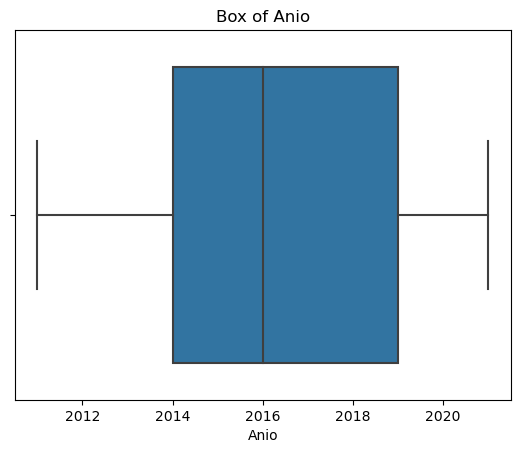

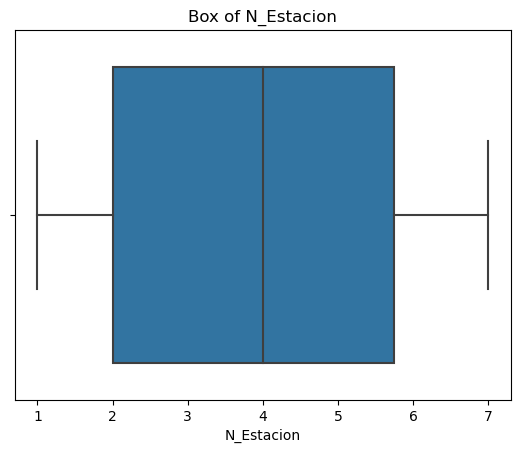

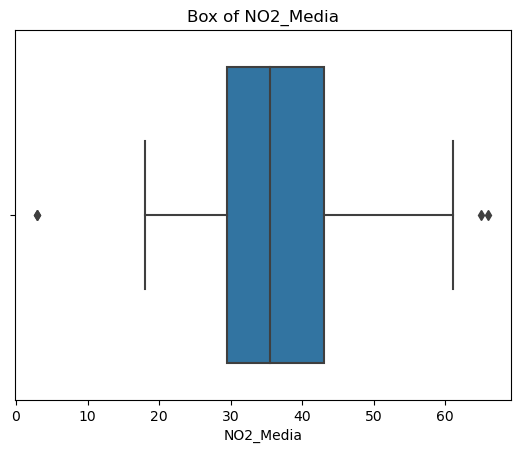

In [465]:
# Obtén las columnas numéricas del DataFrame
numeric_columns = df_contaminacion.select_dtypes(include=['number']).columns

# Itera a través de las columnas numéricas y genera gráficos de caja
for column in numeric_columns:
    sns.boxplot(data=df_contaminacion, x=column)
    plt.title(f"Box of {column}")
    plt.show()

In [466]:
# Encuentra los outliers en el DataFrame
Q1 = df_contaminacion.quantile(0.25)
Q3 = df_contaminacion.quantile(0.75)
IQR = Q3 - Q1
outliers = ((df_contaminacion < (Q1 - 1.5 * IQR)) | (df_contaminacion > (Q3 + 1.5 * IQR))).any(axis=1)

# Crea un nuevo DataFrame solo con los outliers
outliers_df = df_contaminacion[outliers]

# Imprime el DataFrame de outliers
print(outliers_df)

   ID_Contaminacion  Anio  N_Estacion     Nombre_Estacion  NO2_Media
1              1102  2011           2            Eixample       65.0
2              1106  2011           6              Gracia       66.0
31             1505  2015           5  Parc Vall d'Hebron        3.0
38             1605  2016           5  Parc Vall d'Hebron        3.0


In [473]:
# Reemplaza 'df' con el nombre de tu DataFrame
nombre_estacion = "Parc Vall d'Hebron"

# Filtra el DataFrame para obtener las filas correspondientes a la estación 'Parc Vall d'Hebron' en los años 2015 y 2016
filtro_años = (df_contaminacion['Nombre_Estacion'] == nombre_estacion) & ((df_contaminacion['Anio'] == 2015) | (df_contaminacion['Anio'] == 2016))

# Calcula la media de 'NO2_Media' para la estación 'Parc Vall d'Hebron' en los años 2014 y 2017
filtro_media = (df_contaminacion['Nombre_Estacion'] == nombre_estacion) & ((df_contaminacion['Anio'] == 2014) | (df_contaminacion['Anio'] == 2017))
media_estacion_2014_2017 = df_contaminacion.loc[filtro_media, 'NO2_Media'].mean()

# Reemplaza los valores de 'NO2_Media' en los años 2015 y 2016 por la media de 2014 y 2017
df_contaminacion.loc[filtro_años, 'NO2_Media'] = media_estacion_2014_2017


In [474]:
df_2015 = df_contaminacion[df_contaminacion['N_Estacion'] == 5]
df_2015

,ID_Contaminacion,Anio,N_Estacion,Nombre_Estacion,NO2_Media
5,1105,2011,5,Parc Vall d'Hebron,33.0
10,1205,2012,5,Parc Vall d'Hebron,31.0
17,1305,2013,5,Parc Vall d'Hebron,27.0
24,1405,2014,5,Parc Vall d'Hebron,28.0
31,1505,2015,5,Parc Vall d'Hebron,30.0
38,1605,2016,5,Parc Vall d'Hebron,30.0
45,1705,2017,5,Parc Vall d'Hebron,32.0
52,1805,2018,5,Parc Vall d'Hebron,29.0
59,1905,2019,5,Parc Vall d'Hebron,29.0
66,2005,2020,5,Parc Vall d'Hebron,22.0


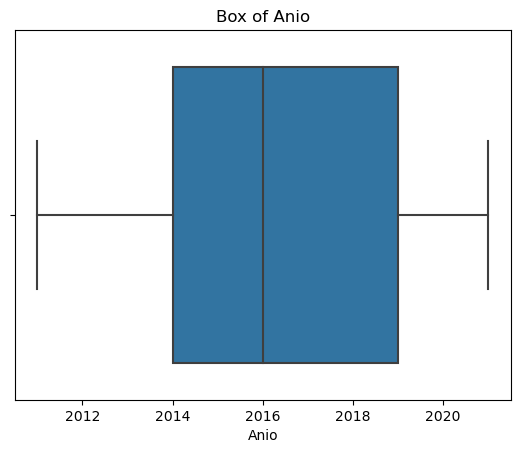

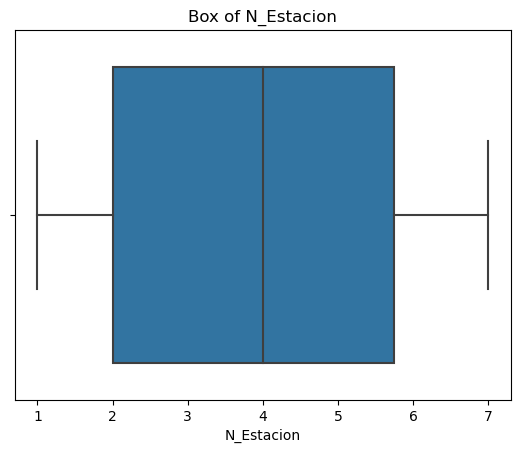

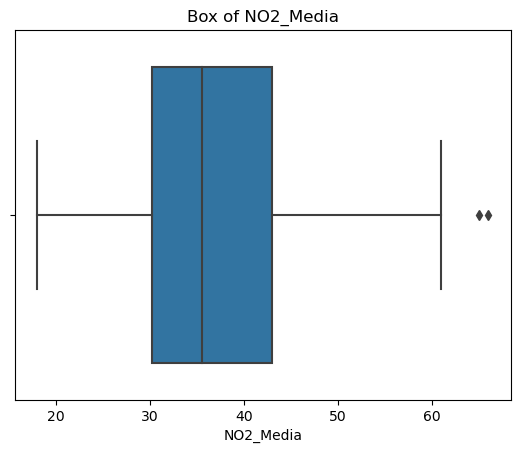

In [475]:
# Obtén las columnas numéricas del DataFrame
numeric_columns = df_contaminacion.select_dtypes(include=['number']).columns

# Itera a través de las columnas numéricas y genera gráficos de caja
for column in numeric_columns:
    sns.boxplot(data=df_contaminacion, x=column)
    plt.title(f"Box of {column}")
    plt.show()

In [477]:
# Contaminación - Info
df_contaminacion.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 74 entries, 0 to 73
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   ID_Contaminacion  74 non-null     object 
 1   Anio              74 non-null     int32  
 2   N_Estacion        74 non-null     int32  
 3   Nombre_Estacion   74 non-null     object 
 4   NO2_Media         74 non-null     float64
dtypes: float64(1), int32(2), object(2)
memory usage: 4.9+ KB


In [478]:
# Contaminación - Summary
summary_contaminacion = df_contaminacion.describe().T
summary_contaminacion

,count,mean,std,min,25%,50%,75%,max
Anio,74.0,2016.175676,3.120231,2011.0,2014.00,2016.0,2019.00,2021.0
N_Estacion,74.0,3.891892,1.976350,1.0,2.00,4.0,5.75,7.0
NO2_Media,74.0,37.729730,11.056886,18.0,30.25,35.5,43.00,66.0


In [479]:
# Contaminación - Guardar el DataFrame en un archivo CSV
df_contaminacion.to_csv('df_Contaminacion.csv', index=False)

### Base de Datos

In [144]:
# Creo una Base de Datos 
import mysql.connector
from dotenv import load_dotenv
import warnings
import os

# Carga las variables de entorno desde el archivo .env
load_dotenv()

# Obtiene la contraseña de acceso a MySQL desde las variables de entorno
passsql = os.getenv('pass_mysql')

# Configura las credenciales de acceso a MySQL
usuario = 'root'
contrasena = passsql
host = 'localhost'
puerto = '3306'
base_de_datos = 'finalproject'

In [ ]:
# Conecta a MySQL
conexion = mysql.connector.connect(
    user=usuario,
    password=contrasena,
    host=host,
    port=puerto
)

# Crea la base de datos 'finalproject' si no existe
cursor = conexion.cursor()
cursor.execute(f"CREATE DATABASE IF NOT EXISTS {base_de_datos}")
conexion.close()

In [480]:
# Conecta a la base de datos 'finalproject'
conexion = mysql.connector.connect(
    user=usuario,
    password=contrasena,
    host=host,
    port=puerto,
    database=base_de_datos
)

In [146]:
# Movilidad - Creo la tabla 'movilidad'
cursor = conexion.cursor()
cursor.execute("""
    CREATE TABLE IF NOT EXISTS movilidad (
        ID_Movilidad INT PRIMARY KEY,
        Anio INT,
        N_Distrito INT,
        Nombre_Distrito VARCHAR(255),
        Movilidad_Activa FLOAT,
        Transporte_Privado FLOAT,
        Transporte_Publico FLOAT,
        TOTAL FLOAT
    )
""")
conexion.commit()

# Carga datos desde un archivo CSV a la tabla 'movilidad'
archivo_csv = './df_Movilidad.csv'

with open(archivo_csv, 'r') as archivo:
    cursor = conexion.cursor()
    siguiente_linea = True
    for linea in archivo:
        if siguiente_linea:
            siguiente_linea = False
            continue
        campos = linea.strip().split(',')
        cursor.execute("""
            INSERT INTO movilidad (ID_Movilidad, Anio, N_Distrito, Nombre_Distrito, Movilidad_Activa, Transporte_Privado, Transporte_Publico, TOTAL)
            VALUES (%s, %s, %s, %s, %s, %s, %s, %s)  
        """, campos)
    conexion.commit()

In [481]:
# Contaminación - Creo la tabla 'Contaminacion'
cursor = conexion.cursor()
cursor.execute("""
    CREATE TABLE IF NOT EXISTS contaminacion (
        ID_contaminacion INT PRIMARY KEY,
        Anio INT,
        N_Estacion INT,
        Nombre_Estacion VARCHAR(255),
        NO2_Media FLOAT
    )
""")
conexion.commit()

# Carga datos desde un archivo CSV a la tabla 'Contaminacion'
archivo_csv = './df_Contaminacion.csv'

with open(archivo_csv, 'r') as archivo:
    cursor = conexion.cursor()
    siguiente_linea = True
    for linea in archivo:
        if siguiente_linea:
            siguiente_linea = False
            continue
        campos = linea.strip().split(',')
        cursor.execute("""
            INSERT INTO contaminacion (ID_contaminacion, Anio, N_Estacion, Nombre_Estacion, NO2_Media)
            VALUES (%s, %s, %s, %s, %s) 
        """, campos)
    conexion.commit()

In [445]:
# Asignacion de Estaciones - Creo la tabla 'Asignación_Estaciones'
cursor.execute("""
    CREATE TABLE IF NOT EXISTS asignaciones (
        N_Distrito INT PRIMARY KEY,
        N_Estacion INT,
        Nombre_Estacion VARCHAR(255)        
    )
""")

# Carga datos desde un archivo CSV a la tabla 'df_asignaciones'
archivo_csv = './df_asignaciones.csv'

with open(archivo_csv, 'r') as archivo:
    cursor = conexion.cursor()
    siguiente_linea = True
    for linea in archivo:
        if siguiente_linea:
            siguiente_linea = False
            continue
        campos = linea.strip().split(',')
        cursor.execute("""
            INSERT INTO asignaciones (
                N_Distrito,
                N_Estacion,
                Nombre_Estacion
                )
            VALUES (%s, %s, %s)
        """, campos)
    conexion.commit()

    conexion.commit()


In [453]:
df_estaciones

,N_Estacion,Nombre_Estacion,Lat,Long
0,1,Ciutadella,41.38641,2.1874
1,2,Eixample,41.38531,2.1538
2,3,Poblenou,41.40388,2.2045
3,4,Sants,41.37878,2.1331
4,5,Parc Vall d'Hebron,41.42611,2.1480
5,6,Gracia,41.39872,2.1534
6,7,Palau Reial,41.38749,2.1152


In [451]:
df_estaciones.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7 entries, 0 to 6
Data columns (total 4 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   N_Estacion       7 non-null      int64  
 1   Nombre_Estacion  7 non-null      object 
 2   Lat              7 non-null      float64
 3   Long             7 non-null      float64
dtypes: float64(2), int64(1), object(1)
memory usage: 352.0+ bytes


In [7]:
# Cerrar la conexión
conexion.close()


In [312]:
# Conecta a la base de datos 'finalproject'
conexion = mysql.connector.connect(
    user=usuario,
    password=contrasena,
    host=host,
    port=puerto,
    database=base_de_datos
)


In [460]:
# Estaciones - Creo la tabla 'Estaciones'
cursor = conexion.cursor()
cursor.execute("""
    CREATE TABLE IF NOT EXISTS estaciones (
        N_Estacion INT PRIMARY KEY,
        Nombre_Estacion VARCHAR(255),
        Lat FLOAT,
        `Long` FLOAT
    )
""")
conexion.commit()

# Carga datos desde un archivo CSV a la tabla 'Estaciones'
archivo_csv = './df_Estaciones.csv'

with open(archivo_csv, 'r') as archivo:
    cursor = conexion.cursor()
    siguiente_linea = True
    for linea in archivo:
        if siguiente_linea:
            siguiente_linea = False
            continue
        campos = linea.strip().split(',')
        
        # Escapa la cadena 'Nombre_Estacion' utilizando MySQLConverter.escape
        campos[2] = mysql.connector.conversion.MySQLConverter().escape(campos[2])
        
        # Asegúrate de que la cantidad de elementos coincida con los marcadores de posición
        cursor.execute("""
            INSERT INTO estaciones (
                N_Estacion,
                Nombre_Estacion,
                Lat,
                `Long`)
            VALUES (%s, %s, %s, %s)
        """, (campos[0], campos[1], campos[2], campos[3]))
    conexion.commit()

In [461]:
df_Distritos

,N_Distrito,Nombre_Distrito,Superficie_km2,Poblacion_2019,Densidad_hab/km2
0,1,Ciudad Vieja,4.11,103429.0,25159.09
1,2,Ensanche,7.46,265910.0,35625.67
2,3,Sants-Montjuïc,22.68,184091.0,8118.32
3,4,Les Corts,6.02,81974.0,13607.11
4,5,Sarriá-San Gervasio|,19.91,149260.0,7497.11
5,6,Gracia,4.19,121798.0,29082.62
6,7,Horta-Guinardó,11.96,171495.0,14342.64
7,8,Nou Barris,8.05,170669.0,21198.48
8,9,San Andrés,6.59,149821.0,22724.25
9,10,San Martín,10.39,238315.0,22943.58


In [462]:
# Distritos - Creo la tabla 'Distritos' 
cursor = conexion.cursor()
cursor.execute("""
    CREATE TABLE IF NOT EXISTS distritos (
        N_Distrito INT PRIMARY KEY,
        Nombre_Distrito VARCHAR(255),
        Superficie_km2 FLOAT,
        Poblacion_2019 INT,
        Densidad_hab_km2 FLOAT
    )
""")
conexion.commit()

# Carga datos desde un archivo CSV a la tabla 'df_Distritos'
archivo_csv = './df_Distritos.csv'

with open(archivo_csv, 'r') as archivo:
    cursor = conexion.cursor()
    siguiente_linea = True
    for linea in archivo:
        if siguiente_linea:
            siguiente_linea = False
            continue
        campos = linea.strip().split(',')
        cursor.execute("""
            INSERT INTO distritos (
                N_Distrito,
                Nombre_Distrito,
                Superficie_km2,
                Poblacion_2019,
                Densidad_hab_km2)
            VALUES (%s, %s, %s, %s, %s)
        """, campos)
    conexion.commit()

In [467]:
# Cerrar la conexión
conexion.close()

### DataFrame

In [482]:
# Conecta a MySQL
conexion = mysql.connector.connect(
    user=usuario,
    password=contrasena,
    host=host,
    port=puerto
)

# Selecciona la base de datos 'finalproject'
cursor = conexion.cursor()
cursor.execute(f"USE {base_de_datos}")

# Extarigo mi DataFrame Final
sql_query = """
SELECT
    m.Anio AS Año,
    m.N_Distrito,
    a.N_Estacion,
    ROUND(m.Movilidad_Activa / m.TOTAL, 4) AS '% Movilidad',
    ROUND(m.Movilidad_Activa / df.Superficie_km2, 4) AS 'Movilidad/Km2',
    c.NO2_Media
FROM
    movilidad m
JOIN distritos df ON m.N_Distrito = df.N_Distrito
JOIN asignaciones a ON m.N_Distrito = a.N_Distrito
JOIN contaminacion c ON m.Anio = c.Anio AND a.N_Estacion = c.N_Estacion;
"""

# Ejecuta la consulta y guarda el resultado en un DataFrame
df_resultado = pd.read_sql_query(sql_query, conexion)

# Cerrar la conexión
conexion.close()

In [483]:
df_resultado

,Año,N_Distrito,N_Estacion,% Movilidad,Movilidad/Km2,NO2_Media
0,2011,1,1,0.5257,42.9234,40.0
1,2011,2,2,0.4832,54.8637,65.0
2,2011,3,4,0.5824,15.9813,40.0
3,2011,5,6,0.4907,12.3697,66.0
4,2011,6,6,0.5027,49.0644,66.0
...,...,...,...,...,...,...
101,2021,6,6,0.5719,50.4088,31.0
102,2021,7,5,0.4841,19.7651,20.0
103,2021,8,5,0.4877,28.2220,20.0
104,2021,9,3,0.5676,40.2780,26.0


In [484]:
df_resultado.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 106 entries, 0 to 105
Data columns (total 6 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Año            106 non-null    int64  
 1   N_Distrito     106 non-null    int64  
 2   N_Estacion     106 non-null    int64  
 3   % Movilidad    106 non-null    float64
 4   Movilidad/Km2  106 non-null    float64
 5   NO2_Media      106 non-null    float64
dtypes: float64(3), int64(3)
memory usage: 5.1 KB


In [485]:
df_resultado_1 = df_resultado.copy()

In [486]:
df_2011 = df_resultado_1[df_resultado_1['Año'] == 2011]
df_2011

,Año,N_Distrito,N_Estacion,% Movilidad,Movilidad/Km2,NO2_Media
0,2011,1,1,0.5257,42.9234,40.0
1,2011,2,2,0.4832,54.8637,65.0
2,2011,3,4,0.5824,15.9813,40.0
3,2011,5,6,0.4907,12.3697,66.0
4,2011,6,6,0.5027,49.0644,66.0
5,2011,7,5,0.4438,20.9986,33.0
6,2011,8,5,0.5155,33.3764,33.0
7,2011,9,3,0.5441,40.6341,43.0
8,2011,10,3,0.5017,38.7459,43.0


In [487]:
# Calcula la matriz de correlación
df_corr = df_resultado_1.corr()
df_corr

,Año,N_Distrito,N_Estacion,% Movilidad,Movilidad/Km2,NO2_Media
Año,1.000000,-0.014542,0.068934,0.245627,0.036629,-0.478285
N_Distrito,-0.014542,1.000000,0.251494,-0.216813,-0.160104,-0.148899
N_Estacion,0.068934,0.251494,1.000000,-0.434395,-0.582445,-0.156098
% Movilidad,0.245627,-0.216813,-0.434395,1.000000,0.571145,-0.204266
Movilidad/Km2,0.036629,-0.160104,-0.582445,0.571145,1.000000,0.325532
NO2_Media,-0.478285,-0.148899,-0.156098,-0.204266,0.325532,1.000000


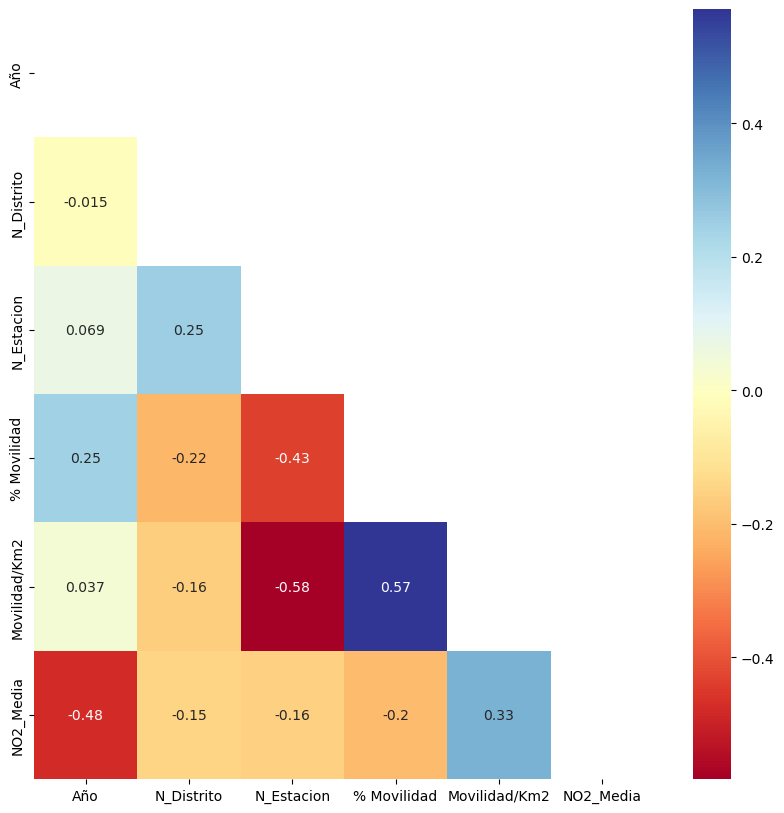

In [488]:
# Crea una máscara para ocultar la mitad superior de la matriz
mask = np.zeros_like(df_corr)
mask[np.triu_indices_from(mask)] = True

# Crea una figura y un eje para el mapa de calor
fig, ax = plt.subplots(figsize=(10, 10))

# Crea un mapa de calor con anotaciones
ax = sns.heatmap(df_corr, mask=mask, annot=True, cmap='RdYlBu')

# Muestra el mapa de calor
plt.show()

objetivo es reducir la concentración de NO2, podrías enfocarte en las áreas con mayores valores negativos de correlación con NO2_Media, como la variable "Año". Si estás interesado en la relación entre la movilidad y la concentración de NO2, podrías investigar más a fondo la relación positiva con "Movilidad/Km2".

En general, estas correlaciones pueden proporcionar pistas sobre las relaciones en tus datos, pero es importante realizar un análisis más profundo y considerar factores adicionales antes de tomar decisiones importantes.

In [489]:
df_resultado.shape

(106, 6)

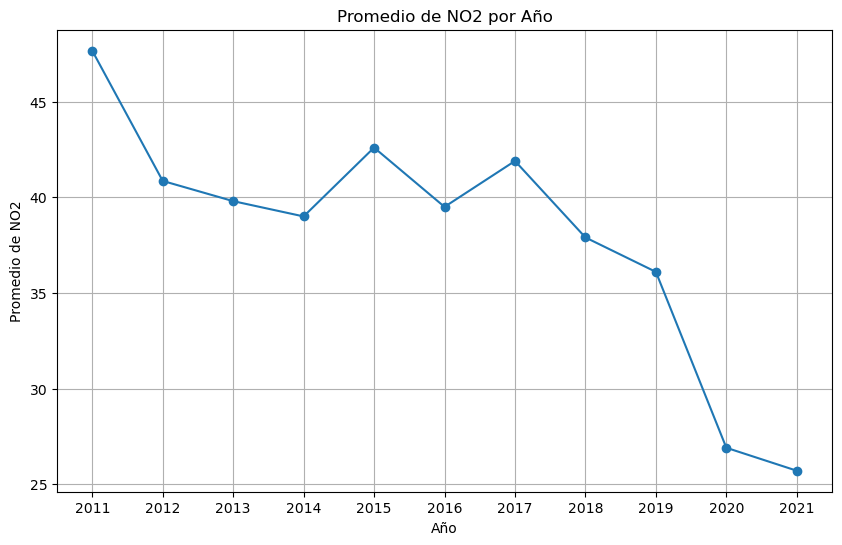

In [490]:
# Agrupa los datos por año y calcula el promedio de NO2 para cada año
promedio_no2_por_anio = df_resultado.groupby('Año')['NO2_Media'].mean()

# Crea una copia del índice (los años) con el formato deseado
anios_formateados = pd.to_datetime(promedio_no2_por_anio.index, format='%Y').strftime('%Y')

# Gráfico con el eje x mostrando el formato deseado
plt.figure(figsize=(10, 6))
plt.plot(anios_formateados, promedio_no2_por_anio.values, marker='o', linestyle='-')
plt.title('Promedio de NO2 por Año')
plt.xlabel('Año')
plt.ylabel('Promedio de NO2')
plt.grid(True)
plt.show()

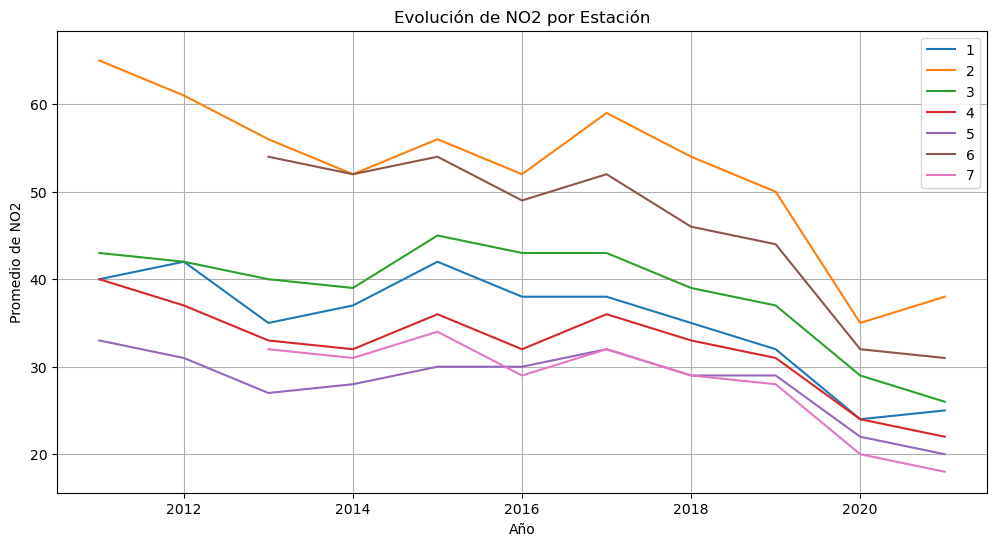

In [491]:
# Agrupa los datos por año y estación, y calcula el promedio de NO2 para cada combinación
promedio_no2_por_anio_estacion = df_resultado.groupby(['Año', 'N_Estacion'])['NO2_Media'].mean().unstack()

# Crea un gráfico de líneas para mostrar la evolución de NO2 por estación a lo largo de los años
plt.figure(figsize=(12, 6))

for estacion in promedio_no2_por_anio_estacion.columns:
    plt.plot(promedio_no2_por_anio_estacion.index, promedio_no2_por_anio_estacion[estacion], label=estacion)

plt.xlabel('Año')
plt.ylabel('Promedio de NO2')
plt.title('Evolución de NO2 por Estación')
plt.legend()
plt.grid(True)
plt.show()


In [492]:
df_resultado_1

,Año,N_Distrito,N_Estacion,% Movilidad,Movilidad/Km2,NO2_Media
0,2011,1,1,0.5257,42.9234,40.0
1,2011,2,2,0.4832,54.8637,65.0
2,2011,3,4,0.5824,15.9813,40.0
3,2011,5,6,0.4907,12.3697,66.0
4,2011,6,6,0.5027,49.0644,66.0
...,...,...,...,...,...,...
101,2021,6,6,0.5719,50.4088,31.0
102,2021,7,5,0.4841,19.7651,20.0
103,2021,8,5,0.4877,28.2220,20.0
104,2021,9,3,0.5676,40.2780,26.0


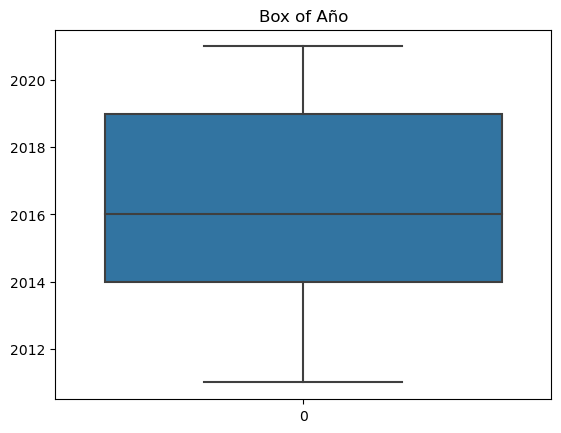

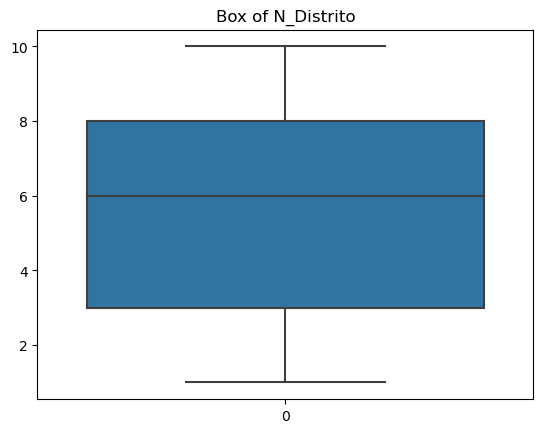

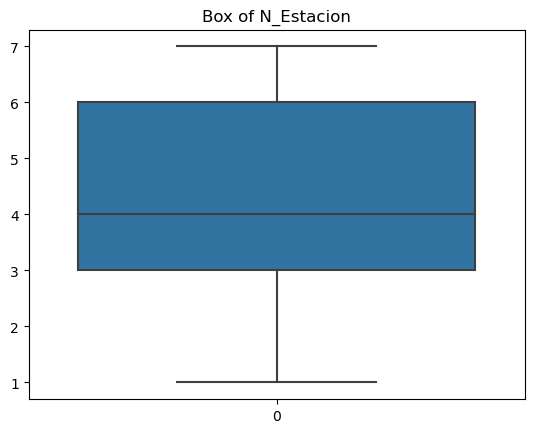

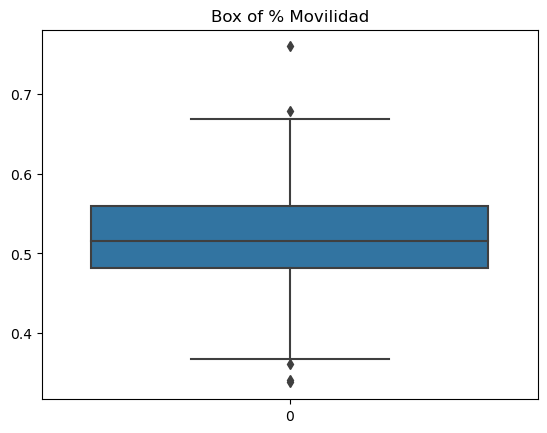

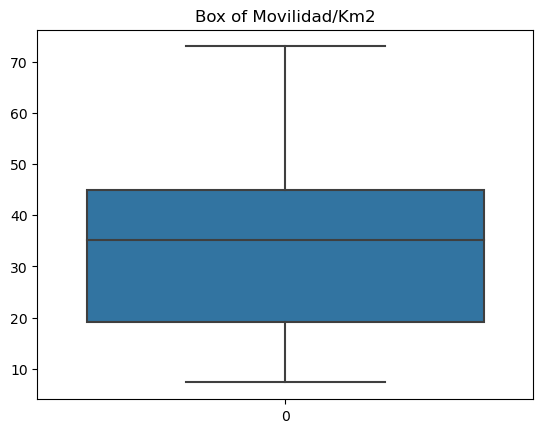

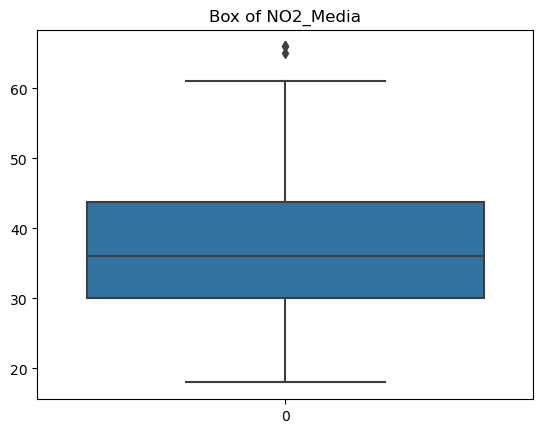

In [493]:
for column in df_resultado.columns:
    sns.boxplot(df_resultado_1[column])
    plt.title(f"Box of {column}")
    plt.show()

In [494]:
# Crear un DataFrame para almacenar outliers
outliers = pd.DataFrame()

# Iterar a través de las columnas del DataFrame y detectar outliers
for column in df_resultado_1.columns:
    if column not in ['Año', 'N_Distrito', 'N_Estacion']:
        q1 = df_resultado_1[column].quantile(0.25)
        q3 = df_resultado_1[column].quantile(0.75)
        iqr = q3 - q1
        lower_bound = q1 - 1.5 * iqr
        upper_bound = q3 + 1.5 * iqr
        column_outliers = df_resultado_1[(df_resultado_1[column] < lower_bound) | (df_resultado_1[column] > upper_bound)]
        column_outliers['Variable'] = column
        outliers = pd.concat([outliers, column_outliers], ignore_index=True)

# Guardar el DataFrame con outliers en un archivo CSV
outliers

,Año,N_Distrito,N_Estacion,% Movilidad,Movilidad/Km2,NO2_Media,Variable
0,2016,4,7,0.3380,13.5625,29.0,% Movilidad
1,2017,5,6,0.3413,7.3362,52.0,% Movilidad
2,2017,7,5,0.3613,13.8605,32.0,% Movilidad
3,2020,1,1,0.7600,61.6321,24.0,% Movilidad
4,2020,2,2,0.6785,72.9471,35.0,% Movilidad
5,2011,2,2,0.4832,54.8637,65.0,NO2_Media
6,2011,5,6,0.4907,12.3697,66.0,NO2_Media
7,2011,6,6,0.5027,49.0644,66.0,NO2_Media


In [495]:
df_2011 = df_movilidad_final[df_movilidad_final['Anio'] == 2021]
df_2011

,ID_Movilidad,Anio,N_Distrito,Nombre_Distrito,Movilidad_Activa,Transporte_Privado,Transporte_Publico,Total
123,2101,2021,1,Ciutat Vella,193.285,37.006,94.589,324.881
124,2102,2021,2,Eixample,501.492,153.735,171.565,826.793
125,2103,2021,3,Sants-Montjuic,291.077,111.337,141.075,543.489
126,2104,2021,4,Les Corts,145.692,62.491,50.360,258.543
127,2105,2021,5,Sarria-Sant Gervasi,239.831,121.765,98.265,459.861
128,2106,2021,6,Gracia,211.213,85.238,72.859,369.310
129,2107,2021,7,Horta-Guinardo,236.390,114.471,137.437,488.299
130,2108,2021,8,Nou Barris,227.187,93.683,144.933,465.803
131,2109,2021,9,Sant Andreu,265.432,95.044,107.124,467.601
132,2110,2021,10,Sant Marti,425.464,148.388,154.626,728.478


In [496]:
df_2020 = df_movilidad_final[df_movilidad_final['Anio'] == 2020]
df_2020

,ID_Movilidad,Anio,N_Distrito,Nombre_Distrito,Movilidad_Activa,Transporte_Privado,Transporte_Publico,Total
111,2001,2020,1,Ciutat Vella,253.308,25.329,54.662,333.300
112,2002,2020,2,Eixample,544.185,147.750,110.104,802.039
113,2003,2020,3,Sants-Montjuic,294.860,97.666,107.894,500.419
114,2004,2020,4,Les Corts,176.951,53.956,33.444,264.350
115,2005,2020,5,Sarria-Sant Gervasi,259.254,136.183,59.699,455.135
116,2006,2020,6,Gracia,250.154,68.424,62.320,380.898
117,2007,2020,7,Horta-Guinardo,271.132,108.942,110.899,490.973
118,2008,2020,8,Nou Barris,294.752,108.715,122.840,526.307
119,2009,2020,9,Sant Andreu,289.878,88.952,81.574,460.405
120,2010,2020,10,Sant Marti,435.258,137.993,139.793,713.044


In [497]:
df_movilidad_final

,ID_Movilidad,Anio,N_Distrito,Nombre_Distrito,Movilidad_Activa,Transporte_Privado,Transporte_Publico,Total
3,1101,2011,1,Ciutat Vella,176.415,40.246,118.921,335.582
4,1102,2011,2,Eixample,409.283,158.457,279.365,847.105
5,1103,2011,3,Sants-Montjuic,362.456,94.530,165.345,622.331
6,1104,2011,4,Les Corts,126.341,66.848,69.340,262.529
7,1105,2011,5,Sarria-Sant Gervasi,246.280,127.305,128.327,501.912
...,...,...,...,...,...,...,...,...
128,2106,2021,6,Gracia,211.213,85.238,72.859,369.310
129,2107,2021,7,Horta-Guinardo,236.390,114.471,137.437,488.299
130,2108,2021,8,Nou Barris,227.187,93.683,144.933,465.803
131,2109,2021,9,Sant Andreu,265.432,95.044,107.124,467.601


In [498]:
Y = df_resultado_1['NO2_Media']
X = df_resultado_1.drop(['NO2_Media'], axis=1)
X = sm.add_constant(X)

X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Crear y ajustar el modelo de regresión lineal
lm = LinearRegression()
model = lm.fit(X_train, y_train)

# Realizar predicciones en el conjunto de prueba
predictions = lm.predict(X_test)

# Calcular el coeficiente de determinación (R2 score)
r2 = r2_score(y_test, predictions)
print("Coeficiente de determinación (R2 score):", r2)



Coeficiente de determinación (R2 score): 0.40618896982216757


In [499]:
X = df_resultado_1.drop(['NO2_Media'], axis=1)
y = df_resultado_1['NO2_Media']

# Utiliza la función `regression_models` para entrenar y evaluar modelos de regresión.
results = regression_models(X, y, test_size=0.2, random_state=42)

# Imprime los resultados
for model_name, metrics in results.items():
    print(f"Model: {model_name}")
    print(f"R-squared: {metrics['R-squared']:.4f}")
    print(f"MSE: {metrics['MSE']:.4f}")
    print(f"MAE: {metrics['MAE']:.4f}")
    print()


Model: Linear Regression
R-squared: 0.4062
MSE: 72.6167
MAE: 7.3603

Model: Ridge Regression
R-squared: 0.3118
MSE: 84.1570
MAE: 8.4310

Model: Lasso Regression
R-squared: 0.2586
MSE: 90.6685
MAE: 8.7051

Model: Polynomial Regression
R-squared: 0.5748
MSE: 51.9984
MAE: 5.9134



In [500]:
# Supongamos que tienes un DataFrame llamado df_resultado_1 con tus datos

# 1. Escalar los datos con el escalado estándar (z-score)
scaler = StandardScaler()
scaled_data = scaler.fit_transform(df_resultado_1)

# Crear un nuevo DataFrame con los datos escalados
df_scaled = pd.DataFrame(scaled_data, columns=df_resultado_1.columns)

# 2. Normalizar los datos en un rango específico (por ejemplo, [0, 1])
scaler = MinMaxScaler()
normalized_data = scaler.fit_transform(df_resultado_1)

# Crear un nuevo DataFrame con los datos normalizados
df_normalized = pd.DataFrame(normalized_data, columns=df_resultado_1.columns)

# Ahora tienes dos DataFrames, df_scaled y df_normalized, con tus datos escalados y normalizados, respectivamente.


In [501]:
X = df_scaled.drop(['NO2_Media'], axis=1)
y = df_scaled['NO2_Media']

# Utiliza la función `regression_models` para entrenar y evaluar modelos de regresión.
results = regression_models(X, y, test_size=0.2, random_state=42)

# Imprime los resultados
for model_name, metrics in results.items():
    print(f"Model: {model_name}")
    print(f"R-squared: {metrics['R-squared']:.4f}")
    print(f"MSE: {metrics['MSE']:.4f}")
    print(f"MAE: {metrics['MAE']:.4f}")
    print()

Model: Linear Regression
R-squared: 0.4062
MSE: 0.6161
MAE: 0.6780

Model: Ridge Regression
R-squared: 0.4063
MSE: 0.6160
MAE: 0.6796

Model: Lasso Regression
R-squared: -0.1100
MSE: 1.1517
MAE: 0.8615

Model: Polynomial Regression
R-squared: 0.5748
MSE: 0.4412
MAE: 0.5447



In [502]:
X = df_normalized.drop(['NO2_Media'], axis=1)
y = df_normalized['NO2_Media']

# Utiliza la función `regression_models` para entrenar y evaluar modelos de regresión.
results = regression_models(X, y, test_size=0.2, random_state=42)

# Imprime los resultados
for model_name, metrics in results.items():
    print(f"Model: {model_name}")
    print(f"R-squared: {metrics['R-squared']:.4f}")
    print(f"MSE: {metrics['MSE']:.4f}")
    print(f"MAE: {metrics['MAE']:.4f}")
    print()

Model: Linear Regression
R-squared: 0.4062
MSE: 0.0315
MAE: 0.1533

Model: Ridge Regression
R-squared: 0.3528
MSE: 0.0344
MAE: 0.1644

Model: Lasso Regression
R-squared: -0.1100
MSE: 0.0589
MAE: 0.1949

Model: Polynomial Regression
R-squared: 0.5748
MSE: 0.0226
MAE: 0.1232



In [503]:
# Cargar tus datos en df_resultado_1, asumiendo que ya has realizado la limpieza y preparación de datos

# Divide tus datos en características (X) y la variable objetivo (Y)
Y = df_resultado_1['NO2_Media']
X = df_resultado_1.drop(['NO2_Media'], axis=1)

# Divide los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Entrenar un modelo de Random Forest
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

# Realiza predicciones en el conjunto de prueba
rf_predictions = rf_model.predict(X_test)

# Evaluar el modelo de Random Forest
rf_mse = mean_squared_error(y_test, rf_predictions)
rf_mae = mean_absolute_error(y_test, rf_predictions)
rf_r2 = r2_score(y_test, rf_predictions)

print("Random Forest Model:")
print(f"Mean Squared Error (MSE): {rf_mse}")
print(f"Mean Absolute Error (MAE): {rf_mae}")
print(f"R-squared (R2): {rf_r2}")

# Entrenar un modelo de Gradient Boosting
gb_model = GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, random_state=42)
gb_model.fit(X_train, y_train)

# Realiza predicciones en el conjunto de prueba
gb_predictions = gb_model.predict(X_test)

# Evaluar el modelo de Gradient Boosting
gb_mse = mean_squared_error(y_test, gb_predictions)
gb_mae = mean_absolute_error(y_test, gb_predictions)
gb_r2 = r2_score(y_test, gb_predictions)

print("\nGradient Boosting Model:")
print(f"Mean Squared Error (MSE): {gb_mse}")
print(f"Mean Absolute Error (MAE): {gb_mae}")
print(f"R-squared (R2): {gb_r2}")


Random Forest Model:
Mean Squared Error (MSE): 18.756268181818175
Mean Absolute Error (MAE): 3.2859090909090907
R-squared (R2): 0.8466237446779753

Gradient Boosting Model:
Mean Squared Error (MSE): 18.704146657093037
Mean Absolute Error (MAE): 3.4000146646709677
R-squared (R2): 0.8470499597547978


In [504]:
# Cargar tus datos en df_resultado_1, asumiendo que ya has realizado la limpieza y preparación de datos

# Divide tus datos en características (X) y la variable objetivo (Y)
Y = df_scaled['NO2_Media']
X = df_scaled.drop(['NO2_Media'], axis=1)

# Divide los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Entrenar un modelo de Random Forest
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

# Realiza predicciones en el conjunto de prueba
rf_predictions = rf_model.predict(X_test)

# Evaluar el modelo de Random Forest
rf_mse = mean_squared_error(y_test, rf_predictions)
rf_mae = mean_absolute_error(y_test, rf_predictions)
rf_r2 = r2_score(y_test, rf_predictions)

print("Random Forest Model:")
print(f"Mean Squared Error (MSE): {rf_mse}")
print(f"Mean Absolute Error (MAE): {rf_mae}")
print(f"R-squared (R2): {rf_r2}")

# Entrenar un modelo de Gradient Boosting
gb_model = GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, random_state=42)
gb_model.fit(X_train, y_train)

# Realiza predicciones en el conjunto de prueba
gb_predictions = gb_model.predict(X_test)

# Evaluar el modelo de Gradient Boosting
gb_mse = mean_squared_error(y_test, gb_predictions)
gb_mae = mean_absolute_error(y_test, gb_predictions)
gb_r2 = r2_score(y_test, gb_predictions)

print("\nGradient Boosting Model:")
print(f"Mean Squared Error (MSE): {gb_mse}")
print(f"Mean Absolute Error (MAE): {gb_mae}")
print(f"R-squared (R2): {gb_r2}")

Random Forest Model:
Mean Squared Error (MSE): 0.17266453843139234
Mean Absolute Error (MAE): 0.32083768726776785
R-squared (R2): 0.8335835000337907

Gradient Boosting Model:
Mean Squared Error (MSE): 0.19606987086167724
Mean Absolute Error (MAE): 0.35305674026221784
R-squared (R2): 0.8110251128920019


In [505]:
def entrenar_evaluar_modelos(df_resultado_1):
    # Divide tus datos en características (X) y la variable objetivo (Y)
    Y = df_resultado_1['NO2_Media']
    X = df_resultado_1.drop(['NO2_Media'], axis=1)

    # Divide los datos en conjuntos de entrenamiento y prueba
    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

    # Entrenar un modelo de Random Forest
    rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
    rf_model.fit(X_train, y_train)

    # Realiza predicciones en el conjunto de prueba
    rf_predictions = rf_model.predict(X_test)

    # Evaluar el modelo de Random Forest
    rf_mse = mean_squared_error(y_test, rf_predictions)
    rf_mae = mean_absolute_error(y_test, rf_predictions)
    rf_r2 = r2_score(y_test, rf_predictions)

    # Entrenar un modelo de Gradient Boosting
    gb_model = GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, random_state=42)
    gb_model.fit(X_train, y_train)

    # Realiza predicciones en el conjunto de prueba
    gb_predictions = gb_model.predict(X_test)

    # Evaluar el modelo de Gradient Boosting
    gb_mse = mean_squared_error(y_test, gb_predictions)
    gb_mae = mean_absolute_error(y_test, gb_predictions)
    gb_r2 = r2_score(y_test, gb_predictions)

    resultados = {
        "Random Forest": {"MSE": rf_mse, "MAE": rf_mae, "R2": rf_r2},
        "Gradient Boosting": {"MSE": gb_mse, "MAE": gb_mae, "R2": gb_r2}
    }

    return resultados

# Llama a la función y pasa tu DataFrame como argumento
resultados = entrenar_evaluar_modelos(df_resultado_1)

# Imprime los resultados
for modelo, metricas in resultados.items():
    print(f"Modelo: {modelo}")
    print(f"MSE: {metricas['MSE']}")
    print(f"MAE: {metricas['MAE']}")
    print(f"R-squared (R2): {metricas['R2']}")


Modelo: Random Forest
MSE: 18.756268181818175
MAE: 3.2859090909090907
R-squared (R2): 0.8466237446779753
Modelo: Gradient Boosting
MSE: 18.704146657093037
MAE: 3.4000146646709677
R-squared (R2): 0.8470499597547978


In [506]:
# Cargar tus datos en df_resultado_1, asumiendo que ya has realizado la limpieza y preparación de datos

# Divide tus datos en características (X) y la variable objetivo (Y)
Y = df_normalized['NO2_Media']
X = df_normalized.drop(['NO2_Media'], axis=1)

# Divide los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Entrenar un modelo de Random Forest
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

# Realiza predicciones en el conjunto de prueba
rf_predictions = rf_model.predict(X_test)

# Evaluar el modelo de Random Forest
rf_mse = mean_squared_error(y_test, rf_predictions)
rf_mae = mean_absolute_error(y_test, rf_predictions)
rf_r2 = r2_score(y_test, rf_predictions)

print("Random Forest Model:")
print(f"Mean Squared Error (MSE): {rf_mse}")
print(f"Mean Absolute Error (MAE): {rf_mae}")
print(f"R-squared (R2): {rf_r2}")

# Entrenar un modelo de Gradient Boosting
gb_model = GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, random_state=42)
gb_model.fit(X_train, y_train)

# Realiza predicciones en el conjunto de prueba
gb_predictions = gb_model.predict(X_test)

# Evaluar el modelo de Gradient Boosting
gb_mse = mean_squared_error(y_test, gb_predictions)
gb_mae = mean_absolute_error(y_test, gb_predictions)
gb_r2 = r2_score(y_test, gb_predictions)

print("\nGradient Boosting Model:")
print(f"Mean Squared Error (MSE): {gb_mse}")
print(f"Mean Absolute Error (MAE): {gb_mae}")
print(f"R-squared (R2): {gb_r2}")

Random Forest Model:
Mean Squared Error (MSE): 0.00862644610164141
Mean Absolute Error (MAE): 0.06976325757575758
R-squared (R2): 0.8374727884030547

Gradient Boosting Model:
Mean Squared Error (MSE): 0.010117203831472958
Mean Absolute Error (MAE): 0.07980951039510153
R-squared (R2): 0.8093860544060717


In [507]:
def performance_modelos(dataframe, variable_objetivo):
    # Divide tus datos en características (X) y la variable objetivo (Y)
    Y = dataframe[variable_objetivo]
    X = dataframe.drop([variable_objetivo], axis=1)

    # Divide los datos en conjuntos de entrenamiento y prueba
    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

    # Entrenar un modelo de Regresión Lineal
    lr_model = LinearRegression()
    lr_model.fit(X_train, y_train)

    # Realiza predicciones en el conjunto de prueba
    lr_predictions = lr_model.predict(X_test)

    # Evaluar el modelo de Regresión Lineal
    lr_mse = mean_squared_error(y_test, lr_predictions)
    lr_mae = mean_absolute_error(y_test, lr_predictions)
    lr_r2 = r2_score(y_test, lr_predictions)

    # Entrenar un modelo de Regresión Ridge
    ridge_model = Ridge()
    ridge_model.fit(X_train, y_train)

    # Realiza predicciones en el conjunto de prueba
    ridge_predictions = ridge_model.predict(X_test)

    # Evaluar el modelo de Regresión Ridge
    ridge_mse = mean_squared_error(y_test, ridge_predictions)
    ridge_mae = mean_absolute_error(y_test, ridge_predictions)
    ridge_r2 = r2_score(y_test, ridge_predictions)

    # Entrenar un modelo de Regresión Lasso
    lasso_model = Lasso()
    lasso_model.fit(X_train, y_train)

    # Realiza predicciones en el conjunto de prueba
    lasso_predictions = lasso_model.predict(X_test)

    # Evaluar el modelo de Regresión Lasso
    lasso_mse = mean_squared_error(y_test, lasso_predictions)
    lasso_mae = mean_absolute_error(y_test, lasso_predictions)
    lasso_r2 = r2_score(y_test, lasso_predictions)

    # Entrenar un modelo de Regresión Polinómica (grado 2)
    poly = PolynomialFeatures(degree=2)
    X_train_poly = poly.fit_transform(X_train)
    X_test_poly = poly.transform(X_test)
    poly_model = LinearRegression()
    poly_model.fit(X_train_poly, y_train)

    # Realiza predicciones en el conjunto de prueba
    poly_predictions = poly_model.predict(X_test_poly)

    # Evaluar el modelo de Regresión Polinómica
    poly_mse = mean_squared_error(y_test, poly_predictions)
    poly_mae = mean_absolute_error(y_test, poly_predictions)
    poly_r2 = r2_score(y_test, poly_predictions)

    # Entrenar un modelo de Random Forest
    rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
    rf_model.fit(X_train, y_train)

    # Realiza predicciones en el conjunto de prueba
    rf_predictions = rf_model.predict(X_test)

    # Evaluar el modelo de Random Forest
    rf_mse = mean_squared_error(y_test, rf_predictions)
    rf_mae = mean_absolute_error(y_test, rf_predictions)
    rf_r2 = r2_score(y_test, rf_predictions)

    # Entrenar un modelo de Gradient Boosting
    gb_model = GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, random_state=42)
    gb_model.fit(X_train, y_train)

    # Realiza predicciones en el conjunto de prueba
    gb_predictions = gb_model.predict(X_test)

    # Evaluar el modelo de Gradient Boosting
    gb_mse = mean_squared_error(y_test, gb_predictions)
    gb_mae = mean_absolute_error(y_test, gb_predictions)
    gb_r2 = r2_score(y_test, gb_predictions)

    resultados = {
        "Linear Regression": {"MSE": lr_mse, "MAE": lr_mae, "R2": lr_r2},
        "Ridge Regression": {"MSE": ridge_mse, "MAE": ridge_mae, "R2": ridge_r2},
        "Lasso Regression": {"MSE": lasso_mse, "MAE": lasso_mae, "R2": lasso_r2},
        "Polynomial Regression": {"MSE": poly_mse, "MAE": poly_mae, "R2": poly_r2},
        "Random Forest": {"MSE": rf_mse, "MAE": rf_mae, "R2": rf_r2},
        "Gradient Boosting": {"MSE": gb_mse, "MAE": gb_mae, "R2": gb_r2}
    }

    return resultados

In [508]:
resultados = performance_modelos(df_resultado_1,'NO2_Media')

# Convierte el diccionario en un DataFrame
df_final = pd.DataFrame(resultados)

# Transpone el DataFrame para que los modelos estén en filas y las métricas en columnas
df_final = df_final.T

# Imprime el DataFrame
df_final


,MSE,MAE,R2
Linear Regression,72.616709,7.360286,0.406189
Ridge Regression,84.157017,8.431028,0.311820
Lasso Regression,90.668495,8.705120,0.258574
Polynomial Regression,51.998387,5.913426,0.574792
Random Forest,18.756268,3.285909,0.846624
Gradient Boosting,18.704147,3.400015,0.847050


In [509]:
resultados = performance_modelos(df_normalized,'NO2_Media')

# Convierte el diccionario en un DataFrame
df_final_norm = pd.DataFrame(resultados)

# Transpone el DataFrame para que los modelos estén en filas y las métricas en columnas
df_final_norm = df_final_norm.T

# Imprime el DataFrame
df_final_norm

,MSE,MAE,R2
Linear Regression,0.031518,0.153339,0.406189
Ridge Regression,0.034353,0.164372,0.352770
Lasso Regression,0.058916,0.194850,-0.110005
Polynomial Regression,0.022569,0.123196,0.574792
Random Forest,0.008626,0.069763,0.837473
Gradient Boosting,0.010117,0.079810,0.809386


In [510]:
resultados = performance_modelos(df_scaled,'NO2_Media')

# Convierte el diccionario en un DataFrame
df_final_sca = pd.DataFrame(resultados)

# Transpone el DataFrame para que los modelos estén en filas y las métricas en columnas
df_final_sca = df_final_sca.T

# Imprime el DataFrame
df_final_sca

,MSE,MAE,R2
Linear Regression,0.616105,0.677960,0.406189
Ridge Regression,0.615983,0.679625,0.406307
Lasso Regression,1.151679,0.861493,-0.110005
Polynomial Regression,0.441172,0.544689,0.574792
Random Forest,0.172665,0.320838,0.833584
Gradient Boosting,0.196070,0.353057,0.811025


In [511]:
def analisis_random_forest(df, variable_objetivo, random_state=42, n_estimators=100):
    # Dividir los datos en características (X) y variable objetivo (Y)
    Y = df[variable_objetivo]
    X = df.drop([variable_objetivo], axis=1)

    # Dividir los datos en conjuntos de entrenamiento y prueba
    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=random_state)

    # Entrenar un modelo de Random Forest
    rf_model = RandomForestRegressor(n_estimators=n_estimators, random_state=random_state)
    rf_model.fit(X_train, y_train)

    # Realizar predicciones en el conjunto de prueba
    rf_predictions = rf_model.predict(X_test)

    # Calcular métricas de rendimiento
    mse = mean_squared_error(y_test, rf_predictions)
    mae = mean_absolute_error(y_test, rf_predictions)
    r2 = r2_score(y_test, rf_predictions)

    # Realizar validación cruzada para obtener una evaluación más robusta
    cv_scores = cross_val_score(rf_model, X, Y, cv=5, scoring='neg_mean_squared_error')
    cv_mse = -cv_scores.mean()

    # Obtener la importancia de las características
    feature_importance = pd.Series(rf_model.feature_importances_, index=X.columns)

    # Devolver un resumen de métricas y características importantes
    resultados = {
        "MSE": mse,
        "MAE": mae,
        "R2": r2,
        "CV MSE": cv_mse,
        "Importancia de características": feature_importance
    }

    return resultados

In [512]:
# Ejemplo de uso:
resultados = analisis_random_forest(df_resultado_1, 'NO2_Media', random_state=42, n_estimators=100)
# Convierte el diccionario en un DataFrame
df_final_rf = pd.DataFrame(resultados)

# Transpone el DataFrame para que los modelos estén en filas y las métricas en columnas
df_final_rf = df_final_rf.T

# Imprime el DataFrame
df_final_rf

,Año,N_Distrito,N_Estacion,% Movilidad,Movilidad/Km2
MSE,18.756268,18.756268,18.756268,18.756268,18.756268
MAE,3.285909,3.285909,3.285909,3.285909,3.285909
R2,0.846624,0.846624,0.846624,0.846624,0.846624
CV MSE,50.503341,50.503341,50.503341,50.503341,50.503341
Importancia de características,0.320071,0.061016,0.101594,0.111296,0.406021


In [513]:
resultados = analisis_random_forest(df_scaled, 'NO2_Media', random_state=42, n_estimators=100)
# Convierte el diccionario en un DataFrame
df_final_rf = pd.DataFrame(resultados)

# Transpone el DataFrame para que los modelos estén en filas y las métricas en columnas
df_final_rf = df_final_rf.T

# Imprime el DataFrame
df_final_rf

,Año,N_Distrito,N_Estacion,% Movilidad,Movilidad/Km2
MSE,0.172665,0.172665,0.172665,0.172665,0.172665
MAE,0.320838,0.320838,0.320838,0.320838,0.320838
R2,0.833584,0.833584,0.833584,0.833584,0.833584
CV MSE,0.420263,0.420263,0.420263,0.420263,0.420263
Importancia de características,0.320805,0.056427,0.103342,0.113512,0.405914


In [514]:
resultados = analisis_random_forest(df_normalized, 'NO2_Media', random_state=42, n_estimators=100)
# Convierte el diccionario en un DataFrame
df_final_rf = pd.DataFrame(resultados)

# Transpone el DataFrame para que los modelos estén en filas y las métricas en columnas
df_final_rf = df_final_rf.T

# Imprime el DataFrame
df_final_rf

,Año,N_Distrito,N_Estacion,% Movilidad,Movilidad/Km2
MSE,0.008626,0.008626,0.008626,0.008626,0.008626
MAE,0.069763,0.069763,0.069763,0.069763,0.069763
R2,0.837473,0.837473,0.837473,0.837473,0.837473
CV MSE,0.021751,0.021751,0.021751,0.021751,0.021751
Importancia de características,0.320733,0.063255,0.100524,0.111144,0.404344


In [515]:
# Crea un modelo (por ejemplo, RandomForestRegressor)
model = RandomForestRegressor(n_estimators=100)

# Especifica el número de pliegues k
k = 5

# Crea un objeto KFold para controlar la división de datos
kf = KFold(n_splits=k, shuffle=True, random_state=42)

# Realiza la validación cruzada y obtén las métricas de rendimiento
scores = cross_val_score(model, X, Y, cv=kf, scoring='neg_mean_squared_error')

# Calcula el promedio de los puntajes de MSE (puedes usar otras métricas)
avg_mse = -scores.mean()

print(f"Promedio de MSE en {k}-fold cross-validation: {avg_mse}")


Promedio de MSE en 5-fold cross-validation: 0.011691184219426411


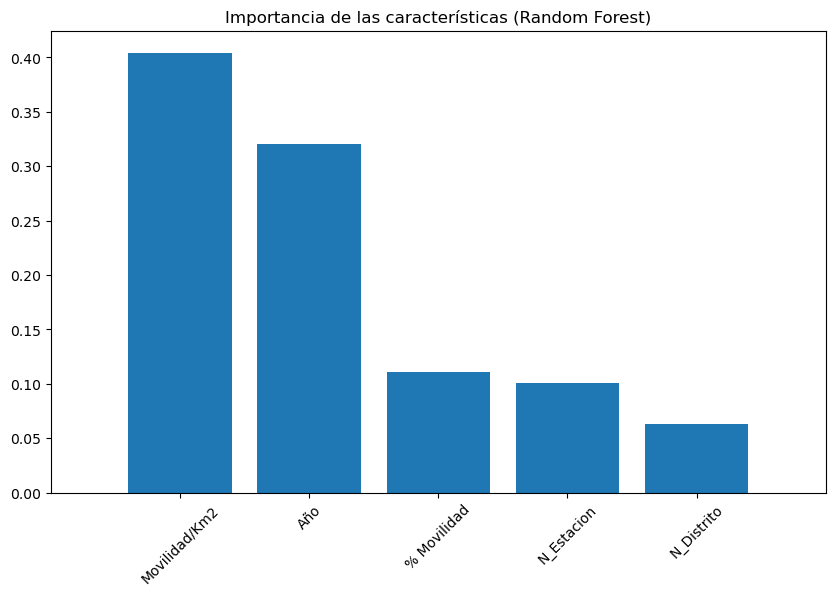

In [516]:
# Obtiene la importancia de las características
importances = rf_model.feature_importances_

# Obtiene los nombres de las características (variables)
feature_names = X_train.columns

# Ordena las importancias en orden descendente
indices = np.argsort(importances)[::-1]

# Crea un gráfico de barras para visualizar la importancia de las características
plt.figure(figsize=(10, 6))
plt.title("Importancia de las características (Random Forest)")
plt.bar(range(X_train.shape[1]), importances[indices], align="center")
plt.xticks(range(X_train.shape[1]), [feature_names[i] for i in indices], rotation=45)
plt.xlim([-1, X_train.shape[1]])
plt.show()

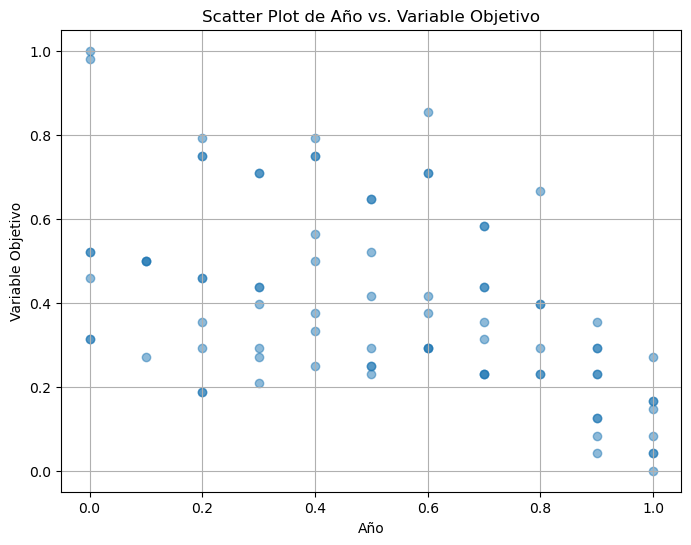

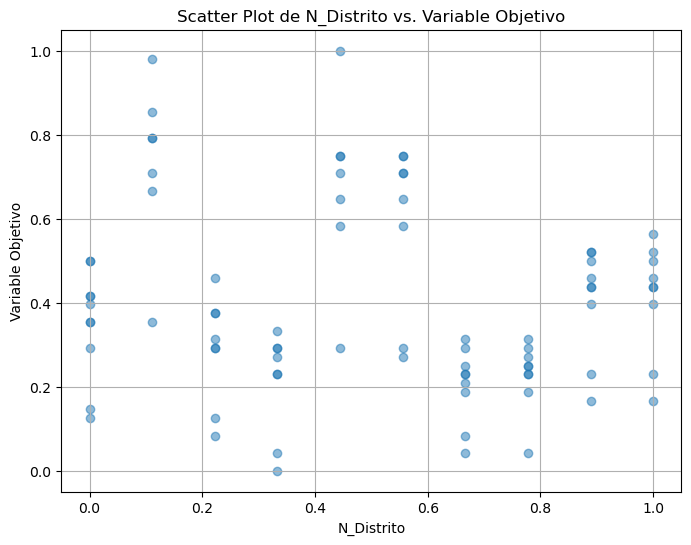

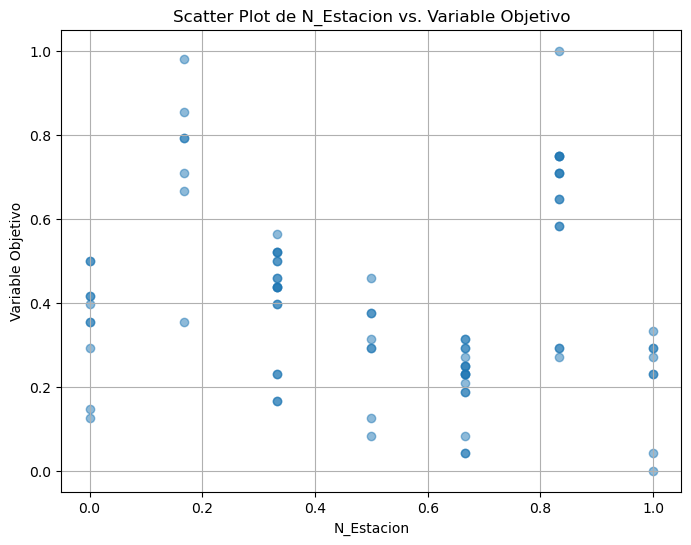

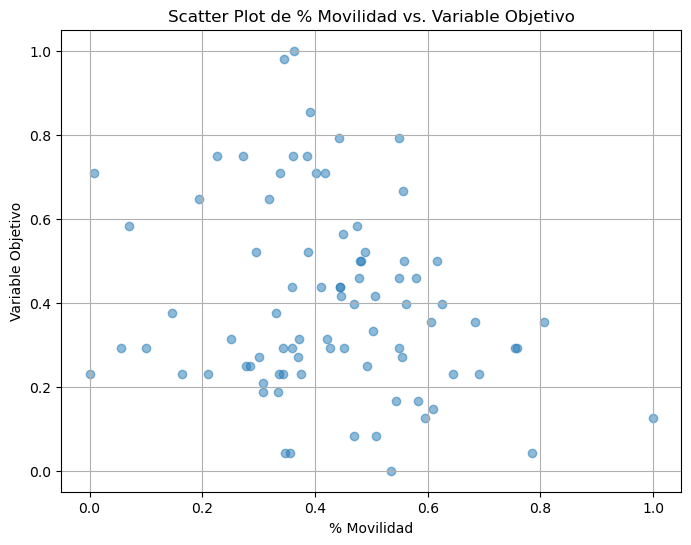

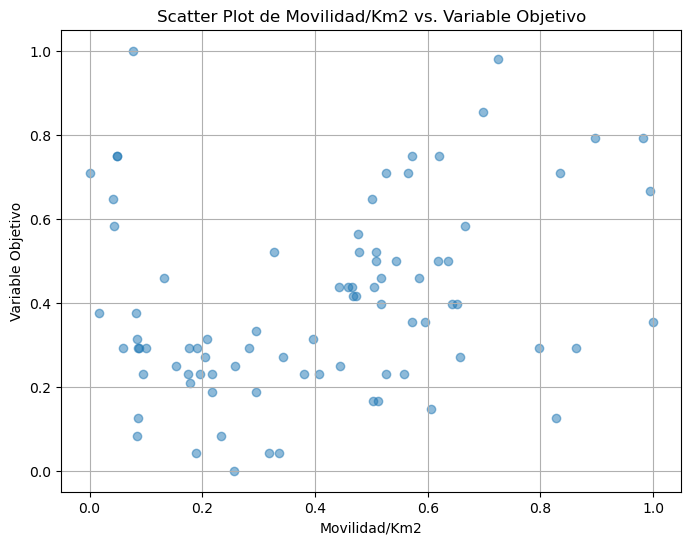

In [526]:
# Obtiene la importancia de las características
importances = rf_model.feature_importances_

# Obtiene los nombres de las características (variables)
feature_names = X_train.columns

# Itera a través de las columnas de tu DataFrame
for feature_name in feature_names:
    plt.figure(figsize=(8, 6))  # Ajusta el tamaño de la figura
    plt.scatter(X_train[feature_name], y_train, alpha=0.5)  # Crea un scatter plot
    plt.title(f"Scatter Plot de {feature_name} vs. Variable Objetivo")  # Título del gráfico
    plt.xlabel(feature_name)  # Etiqueta del eje x
    plt.ylabel("Variable Objetivo")  # Etiqueta del eje y
    plt.grid(True)
    plt.show()  # Muestra el gráfico


In [519]:
def performance_modelos2(dataframe, variable_objetivo):
    # Divide tus datos en características (X) y la variable objetivo (Y)
    Y = dataframe[variable_objetivo]
    X = dataframe.drop([variable_objetivo], axis=1)

    # Divide los datos en conjuntos de entrenamiento y prueba
    X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

    # Entrenar un modelo de Regresión Lineal
    lr_model = LinearRegression()
    lr_model.fit(X_train, y_train)
    lr_predictions = lr_model.predict(X_test)

    # Evaluar el modelo de Regresión Lineal
    lr_mse = mean_squared_error(y_test, lr_predictions)
    lr_mae = mean_absolute_error(y_test, lr_predictions)
    lr_r2 = r2_score(y_test, lr_predictions)

    # Entrenar un modelo de Regresión Ridge
    ridge_model = Ridge()
    ridge_model.fit(X_train, y_train)
    ridge_predictions = ridge_model.predict(X_test)

    # Evaluar el modelo de Regresión Ridge
    ridge_mse = mean_squared_error(y_test, ridge_predictions)
    ridge_mae = mean_absolute_error(y_test, ridge_predictions)
    ridge_r2 = r2_score(y_test, ridge_predictions)

    # Entrenar un modelo de Regresión Polinómica (grado 2)
    poly = PolynomialFeatures(degree=2)
    X_train_poly = poly.fit_transform(X_train)
    X_test_poly = poly.transform(X_test)
    poly_model = LinearRegression()
    poly_model.fit(X_train_poly, y_train)
    poly_predictions = poly_model.predict(X_test_poly)

    # Evaluar el modelo de Regresión Polinómica
    poly_mse = mean_squared_error(y_test, poly_predictions)
    poly_mae = mean_absolute_error(y_test, poly_predictions)
    poly_r2 = r2_score(y_test, poly_predictions)

    # Entrenar un modelo K-Nearest Neighbors (KNN)
    knn_model = KNeighborsRegressor(n_neighbors=5)  # Puedes ajustar el número de vecinos
    knn_model.fit(X_train, y_train)

    # Realiza predicciones en el conjunto de prueba
    knn_predictions = knn_model.predict(X_test)

    # Evaluar el modelo KNN
    knn_mse = mean_squared_error(y_test, knn_predictions)
    knn_mae = mean_absolute_error(y_test, knn_predictions)
    knn_r2 = r2_score(y_test, knn_predictions)

    # Entrenar un modelo de Random Forest
    rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
    rf_model.fit(X_train, y_train)
    rf_predictions = rf_model.predict(X_test)

    # Evaluar el modelo de Random Forest
    rf_mse = mean_squared_error(y_test, rf_predictions)
    rf_mae = mean_absolute_error(y_test, rf_predictions)
    rf_r2 = r2_score(y_test, rf_predictions)

    # Entrenar un modelo de Gradient Boosting
    gb_model = GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, random_state=42)
    gb_model.fit(X_train, y_train)
    gb_predictions = gb_model.predict(X_test)

    # Evaluar el modelo de Gradient Boosting
    gb_mse = mean_squared_error(y_test, gb_predictions)
    gb_mae = mean_absolute_error(y_test, gb_predictions)
    gb_r2 = r2_score(y_test, gb_predictions)

    resultados = {
        "Linear Regression": {"MSE": lr_mse, "MAE": lr_mae, "R2": lr_r2},
        "Ridge Regression": {"MSE": ridge_mse, "MAE": ridge_mae, "R2": ridge_r2},
        "Polynomial Regression": {"MSE": poly_mse, "MAE": poly_mae, "R2": poly_r2},
        "KNN": {"MSE": knn_mse, "MAE": knn_mae, "R2": knn_r2},
        "Random Forest": {"MSE": rf_mse, "MAE": rf_mae, "R2": rf_r2},
        "Gradient Boosting": {"MSE": gb_mse, "MAE": gb_mae, "R2": gb_r2}
    }

    return resultados

In [520]:
performance_modelos2(df_normalized, 'NO2_Media')

{'Linear Regression': {'MSE': 0.0315176689248364,
  'MAE': 0.15333930129661288,
  'R2': 0.4061889698221537},
 'Ridge Regression': {'MSE': 0.03435300927707135,
  'MAE': 0.16437209615532833,
  'R2': 0.35276952501864844},
 'Polynomial Regression': {'MSE': 0.022568744366476642,
  'MAE': 0.12319636938218385,
  'R2': 0.574791861224314},
 'KNN': {'MSE': 0.018424873737373743,
  'MAE': 0.09962121212121211,
  'R2': 0.6528647698857875},
 'Random Forest': {'MSE': 0.00862644610164141,
  'MAE': 0.06976325757575758,
  'R2': 0.8374727884030547},
 'Gradient Boosting': {'MSE': 0.010117203831472958,
  'MAE': 0.07980951039510153,
  'R2': 0.8093860544060717}}

In [521]:
performance_modelos2(df_scaled, 'NO2_Media')

{'Linear Regression': {'MSE': 0.6161054190056002,
  'MAE': 0.6779598107241966,
  'R2': 0.40618896982215713},
 'Ridge Regression': {'MSE': 0.6159830605729252,
  'MAE': 0.6796253224260096,
  'R2': 0.4063069005929576},
 'Polynomial Regression': {'MSE': 0.44117240197866503,
  'MAE': 0.5446887168651684,
  'R2': 0.5747918612243155},
 'KNN': {'MSE': 0.429647374012796,
  'MAE': 0.45720312475062314,
  'R2': 0.5858998445630872},
 'Random Forest': {'MSE': 0.17266453843139234,
  'MAE': 0.32083768726776785,
  'R2': 0.8335835000337907},
 'Gradient Boosting': {'MSE': 0.19606987086167724,
  'MAE': 0.35305674026221784,
  'R2': 0.8110251128920019}}

In [523]:
performance_modelos2(df_resultado_1, 'NO2_Media')

{'Linear Regression': {'MSE': 72.61670920282053,
  'MAE': 7.3602864622372515,
  'R2': 0.40618896982217445},
 'Ridge Regression': {'MSE': 84.15701736328975,
  'MAE': 8.431028460312435,
  'R2': 0.31182002426450894},
 'Polynomial Regression': {'MSE': 51.99838702098861,
  'MAE': 5.913425730325716,
  'R2': 0.5747918612191917},
 'KNN': {'MSE': 50.176363636363654,
  'MAE': 5.536363636363637,
  'R2': 0.5896911536122186},
 'Random Forest': {'MSE': 18.756268181818175,
  'MAE': 3.2859090909090907,
  'R2': 0.8466237446779753},
 'Gradient Boosting': {'MSE': 18.704146657093037,
  'MAE': 3.4000146646709677,
  'R2': 0.8470499597547978}}